# Introduction

The goal of my final project was to further explore the applications of the Fourier Transform beyond the scope of what we covered in class. Particularly, I was keenly interested in performing audio analysis of different instruments and/or vocals, visualizing their wave plots and spectrograms, and audiofying astronomical sources such as gravitational waves. I applied different levels of Fourier filtering to my audio data by zeroing out "bins" with a very low coefficient with respect to the rest of the polynomial. I culminated this project by writing a function to classify audio pitches to one of three notes: A4, F3, and F4; within this subpart of the project the main claim-to-fame of the Fourier transform became apparent.

I'll preface the rest of this report by mentioning that from my experience through this project, I've learned that the Fourier Transform isn't necessarily the best tool for audio analysis, depending on what you're doing and what type of filtering you're employing. Throughout this project I filtered using the zeroing bins strategy, and this doesn't really work when trying to clean noisy or static-y audio: this is why low pass, high pass, and bandpass filters exist. Noise not only adds a lot of extra data to the signal, it also amplifies the original signal present. In doing so, it cannot be completely removed by zeroing out bins in the frequency domain.

There are essentially three parts to this project:
1. Explore the Fourier Transform with instruments and audio samples, and plot spectrograms.
2. Audiofy gravitational waves.
3. Use the Fourier Transform to classify pitches to corresponding frequencies.

For each part, there is a Methodology section, followed by a Results section. At the end, there is an overall conclusion.

At the top of this notebook you'll several functions that are reused throughout to minimize cluttered code. Addtionally, here is a button to toggle on or off the code in the notebook. This was taken from a StackOverflow forum.

In [122]:
# Taken from 
# https://stackoverflow.com/questions/27934885/how-to-hide-code-from-cells-in-ipython-notebook-visualized-with-nbviewer

from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

These are all of the packages used throughout the notebook.

In [123]:
# Import all packages required

import matplotlib.pyplot as plt
import numpy as np
import IPython.display as ipd
import librosa.display
from scipy.io import wavfile
%matplotlib inline

This plotting function is used to make simple waveplots of audio so that the sound can be visualized on a time vs amplitude graph.

In [124]:
# Reusable Plotting Function

def plot(size, xlabel, ylabel, fsize, yscale, xaxis, yaxis=None):
    fig = plt.figure(figsize=size)
    ax = fig.add_subplot(111)
    ax.set_xlabel(xlabel, fontsize=fsize)
    ax.set_ylabel(ylabel, fontsize=fsize)
    # If plotting freq domain of FT
    if (yaxis is None):
        ax.set_yscale(yscale)
        return ax.plot(abs(xaxis))
    return ax.plot(xaxis, yaxis)

This spectrogram plotting function serves a simlar purpose as to the above function, but instead of plotting a simple time vs amplitude graph, it uses the librosa library to plot spectrograms.

In [125]:
# Reusable Spectrogram Plotting Function

def specPlot(data, fs, rows, cols, num, x_label, y_label, cbarLabel, Title):
    D = librosa.stft(data)
    Ddb = librosa.amplitude_to_db(D)
    plt.subplot(rows, cols, num)
    librosa.display.specshow(Ddb, sr=fs, x_axis=x_label, y_axis=y_label)
    plt.colorbar().set_label(cbarLabel)
    plt.title(Title)
    plt.tight_layout()

This function was used to plot filtered signals.

In [126]:
# Reusable Smoothed Signal Plotting Function

def cutoffSmooth(fft_data, cutoff, time_axis):
    copy = np.copy(fft_data)
    copy[cutoff:len(copy)] = 0
    invCopy = np.fft.irfft(copy)
    if (len(time_axis) != len(invCopy)):
        time_axis = time_axis[0:len(time_axis)-1]
    plot((10,5), 'Time (sec)', 'Strain * 1.e21', 12, 'linear', time_axis, invCopy)
    return invCopy

This function was used to audiofy data, and specifically tailored to audiofying the LIGO data from H1 at Hanford, WA and L1 at Livingston, LA.

In [127]:
# Reusable Audiofying Function

def listenGrav(data, sampRate=16386):
    # Lengthen the short timeframe of the audio
    # by creating a repeating signal
    elongated = []
    for i in range(0, 20):
        for each in data:
            elongated.append(each)
        i += 1
    time_elong = np.linspace(0, len(elongated)/sampRate, len(elongated))
    plot((20,5), 'Time (sec)', 'Amplitude', 12, 'linear', time_elong, elongated)
    ipd.display(ipd.Audio(elongated, rate=sampRate))
    return sampRate, np.array(elongated)

This is the classifier. It can classify a given .wav file as one of three frequencies: A4, F3, or F4. It prints the classification of the .wav file, plots its spectrogram, and plots the spectrogram of the note it is classified as.

In [128]:
# Classification Function

def classifier(wavAudio):
    # These are the 3 classifications
    freq_A4 = 7000
    freq_F3 = 2800
    freq_F4 = 5600
    
    # For plotting the classifications' spectrograms
    A4_fs, A4_data = wavfile.read('A4_PopOrgan.wav')
    A4_data = A4_data[:,0]
    
    F3_fs, F3_data = wavfile.read('F3_PopOrgan.wav')
    F3_data = F3_data[:,0]
    
    F4_fs, F4_data = wavfile.read('F4_CathedralOrgan.wav')
    F4_data = F4_data[:,0]
    
    # Read fs and data of .wav input
    aud_fs, aud_data = wavfile.read(wavAudio)
    
    # If it has 2 channels, then only use 1
    if (aud_data.shape[1] == 2):
        aud_data = aud_data[:,0]
    
    t_data = np.linspace(9, len(aud_data)/aud_fs, len(aud_data))
        
    # Convert to the frequency domain
    fft_data = np.fft.rfft(aud_data)
    
    # Find the largest peak
    absVals_fft = abs(fft_data)
    maxCoeff = np.max(absVals_fft)
    
    # Find the index corresponding to that peak
    kVal_max = np.where(absVals_fft == maxCoeff)[0]
    
    # Calculate the distance between the
    # peak and the classifcation notes' peaks
    dist_A4 = abs(kVal_max - freq_A4)
    dist_F3 = abs(kVal_max - freq_F3)
    dist_F4 = abs(kVal_max - freq_F4)
    
    # Classify to the closest classification peak
    minDist = min(dist_A4, dist_F3, dist_F4)
    
    if (minDist == dist_A4):
        print("This audio file is classified as an A4 note")
        plt.figure(figsize=(8,12))
        specPlot(aud_data, aud_fs, 2, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'Spectrogram')
        specPlot(A4_data, A4_fs, 2, 1, 2, 'time', 'log', 'Amplitude (Intensity)', 'A4')
    elif (minDist == dist_F3):
        print("This audio file is classified as an F3 note")
        plt.figure(figsize=(8,12))
        specPlot(aud_data, aud_fs, 2, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'Spectrogram')
        specPlot(F3_data, F3_fs, 2, 1, 2, 'time', 'log', 'Amplitude (Intensity)', 'F3')
    elif (minDist == dist_F4):
        print("This audio file is classified as an F4 note")
        plt.figure(figsize=(8,12))
        specPlot(aud_data, aud_fs, 2, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'Spectrogram')
        specPlot(F4_data, F4_fs, 2, 1, 2, 'time', 'log', 'Amplitude (Intensity)', 'F4')
    else:
        print("Something went wrong")
        return 0

# Methodology: Part 1
In this part, several .wav files pertaining to certain instruments were loaded in and analyzed. Fourier filtering was attempted to clean or alter these files in any way. Since these files were not noisy to begin with, Fourier filtering did very little, except to muffle the audio, effectively compressing the data and decreasing the fidelity.

Pictured below is the first waveplot for a 10 second piano soundtrack. The audio can be listened to using the audio player. Immediately following is the piano sound converted to the frequency domain via a FFT. Due to the Fourier Transform being over such a long period of time, there are a lot peaks, making filtering by zeroing out bins very difficult. This is not something that was realized in the methodology until the very end, otherwise shorter audio samples would have been used to demonstrate the effect of filtering more profoundly.

Nonetheless, the filtered waveplot is pictured below as well. As is apparent, there is very little change. This is for two reasons:
1. Only very low coefficients in the frequency domain were zeroed out
2. The audio is already quite clean, so there is very little noise or imperfection to actually filter. Doing so is like grasping at air.

Following this, the rest of the waveplots and respective filtering are illustrated: Violin, Guitar, Vocal, Synth.

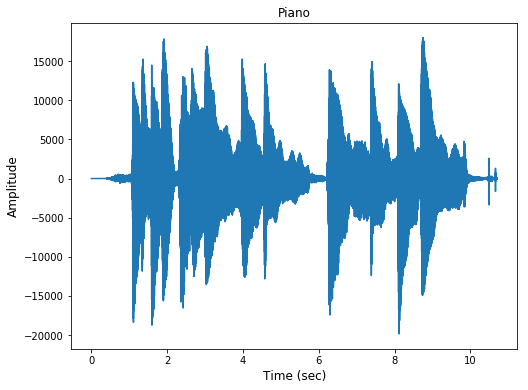

In [129]:
# Piano Analysis: Wave Plot

# Get raw piano data from wav file
piano_fs, piano_data = wavfile.read('piano.wav')

# Make time array
t_piano = np.linspace(0, len(piano_data)/piano_fs, len(piano_data))

# Plot audio wave
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_piano, yaxis=piano_data)
plt.title('Piano', fontsize=12)

# Piano Audio Player
ipd.display(ipd.Audio(piano_data, rate=piano_fs))

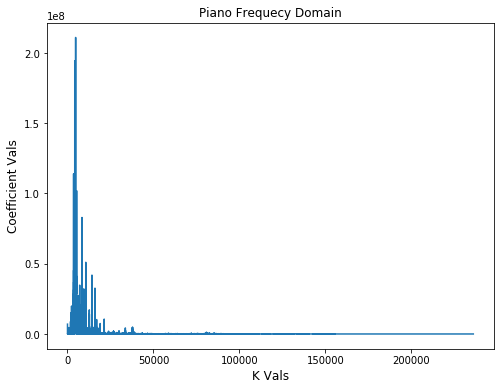

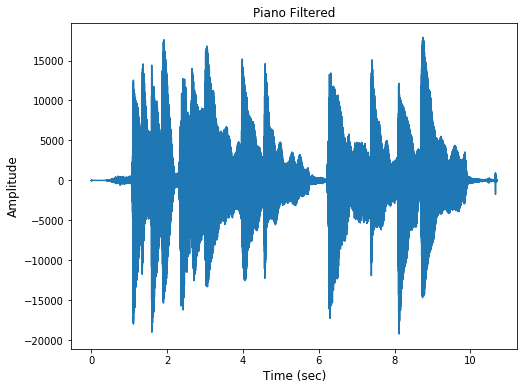

In [130]:
# Piano Analysis: Slight Filtering

# View the freq domain of piano
fft_piano = np.fft.rfft(piano_data)
plot((8,6), "K Vals", "Coefficient Vals", 12, 'linear', fft_piano)
plt.title('Piano Frequecy Domain')

# 30000 beyond are very low coefficients
fft_piano[30000:len(fft_piano)] = 0

# Revert to time domain
piano_filtered = np.fft.irfft(fft_piano)
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_piano, piano_filtered)
plt.title('Piano Filtered', fontsize=12)

# Playback filtered audio
# Note: it sounds compressed
ipd.Audio(piano_filtered, rate=piano_fs)

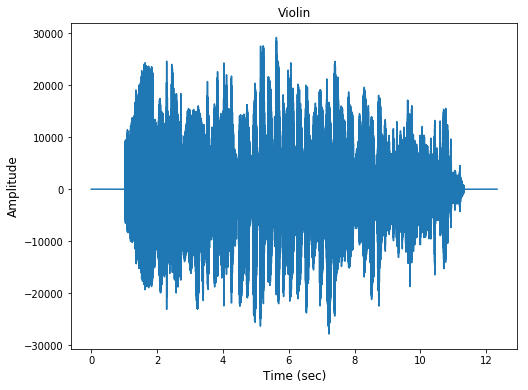

In [131]:
# Violin Analysis: Wave Plot

# Get raw violin data from wav file
violin_fs, violin_data = wavfile.read('violin.wav')
violin_data = violin_data[:,0]

# Make time array
t_violin = np.linspace(0, len(violin_data)/violin_fs, len(violin_data))

# Plot audio wave
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_violin, violin_data)
plt.title('Violin', fontsize=12)

# Violin Audio Player
ipd.Audio(violin_data, rate=violin_fs)

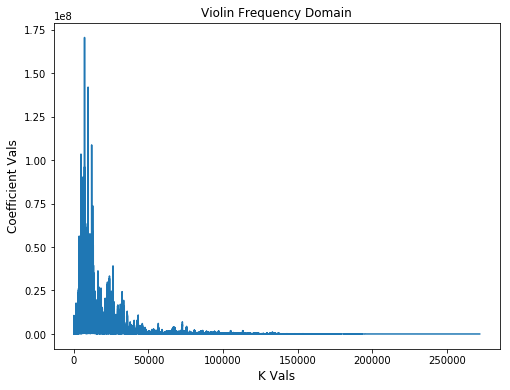

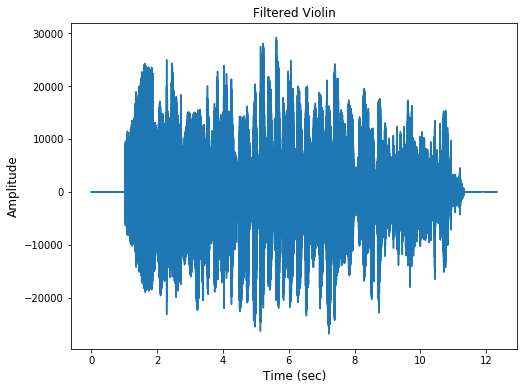

In [132]:
# Violin Analysis: Slight Filtering

# View the freq domain of violin
fft_violin = np.fft.rfft(violin_data)
plot((8,6), "K Vals", "Coefficient Vals", 12, 'linear', fft_violin)
plt.title('Violin Frequency Domain', fontsize=12)

# 50000 beyond are very low coefficients
fft_violin[50000:len(fft_violin)] = 0

# Revert to time domain
violin_filtered = np.fft.irfft(fft_violin)
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_violin, violin_filtered)
plt.title('Filtered Violin', fontsize=12)

# Playback filtered audio
# Note: it sounds compressed
ipd.Audio(violin_filtered, rate=violin_fs)

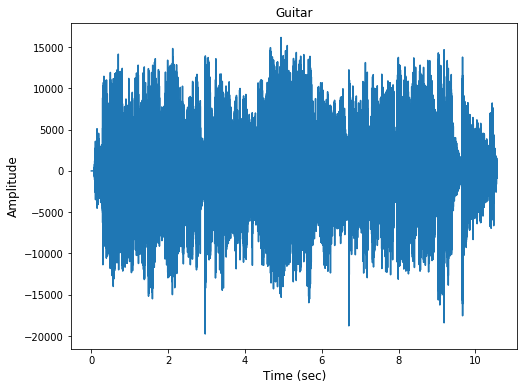

In [133]:
# Guitar Analysis: Wave Plot

# Get raw guitar data from wav file
guitar_fs, guitar_data = wavfile.read('guitar.wav')
guitar_data = guitar_data[:,0]

# Make time array
t_guitar = np.linspace(0, len(guitar_data)/guitar_fs, len(guitar_data))

# Plot audio wave
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_guitar, guitar_data)
plt.title('Guitar', fontsize=12)

# guitar Audio Player
ipd.Audio(guitar_data, rate=guitar_fs)

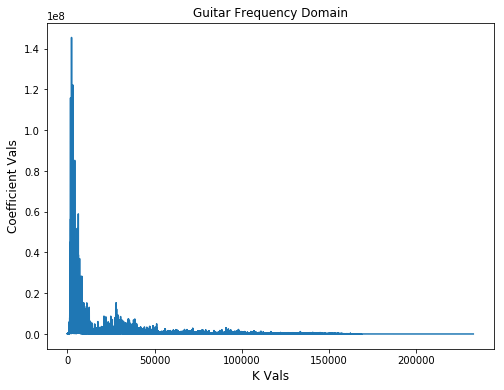

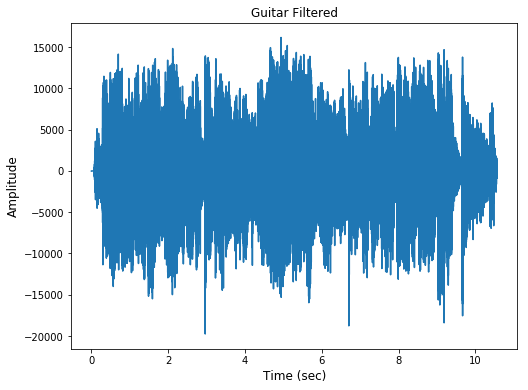

In [134]:
# Guitar Analysis: Slight Filtering

# View the freq domain of guitar
fft_guitar = np.fft.rfft(guitar_data)
plot((8,6), "K Vals", "Coefficient Vals", 12, 'linear', fft_guitar)
plt.title('Guitar Frequency Domain', fontsize=12)

# 50000 beyond are very low coefficients
fft_guitar[175000:len(fft_guitar)] = 0

# Revert to time domain
guitar_filtered = np.fft.irfft(fft_guitar)
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_guitar, guitar_filtered)
plt.title('Guitar Filtered')

# Playback filtered audio
# Note: it sounds compressed
ipd.Audio(guitar_filtered, rate=guitar_fs)

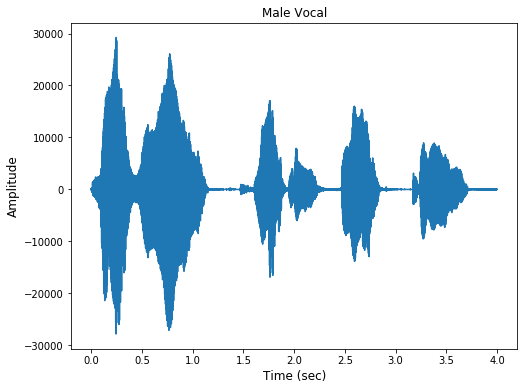

In [135]:
# Male Vocal Analysis: Wave Plot

# Get raw vocal data from wav file
mvocal_fs, mvocal_data = wavfile.read('malevocal.wav')
mvocal_data = mvocal_data[:,0]

# Make time array
t_mvocal = np.linspace(0, len(mvocal_data)/mvocal_fs, len(mvocal_data))

# Plot audio wave
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_mvocal, mvocal_data)
plt.title('Male Vocal', fontsize=12)

# guitar Audio Player
ipd.Audio(mvocal_data, rate=mvocal_fs)

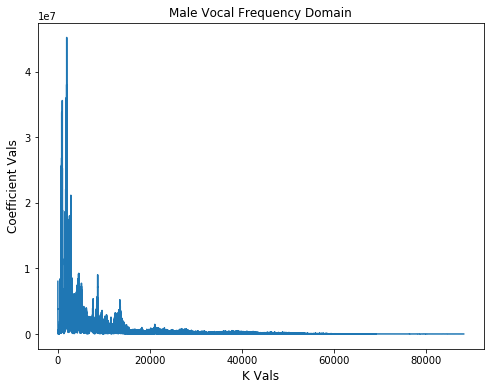

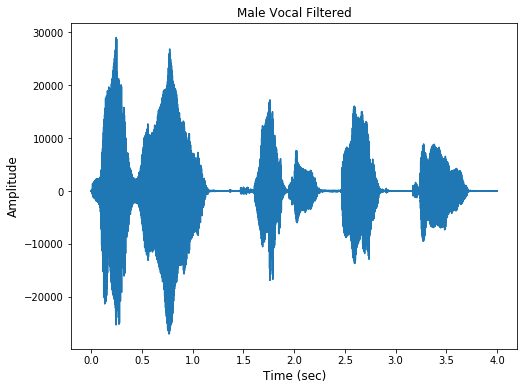

In [136]:
# Vocal Analysis: Slight Filtering

# View the freq domain of vocals
fft_mvocal = np.fft.rfft(mvocal_data)
plot((8,6), "K Vals", "Coefficient Vals", 12, 'linear', fft_mvocal)
plt.title('Male Vocal Frequency Domain')

# 20000 beyond are very low coefficients
fft_mvocal[20000:len(fft_mvocal)] = 0

# Revert to time domain
mvocal_filtered = np.fft.irfft(fft_mvocal)
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_mvocal, mvocal_filtered)
plt.title('Male Vocal Filtered')

# Playback filtered audio
# Note: it sounds compressed
ipd.Audio(mvocal_filtered, rate=mvocal_fs)

/usr/local/lib/python3.6/site-packages/scipy/io/wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


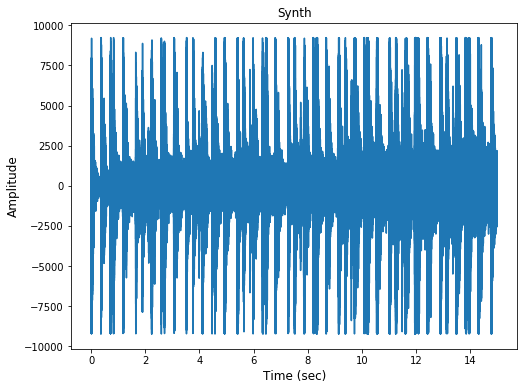

In [137]:
# Synth Analysis: Wave Plot

# Get raw synth data from wav file
synth_fs, synth_data = wavfile.read('synth.wav')
synth_data = synth_data[:,0]

# Make time array
t_synth = np.linspace(0, len(synth_data)/synth_fs, len(synth_data))

# Plot audio wave
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_synth, synth_data)
plt.title('Synth', fontsize=12)

# guitar Audio Player
ipd.Audio(synth_data, rate=synth_fs)

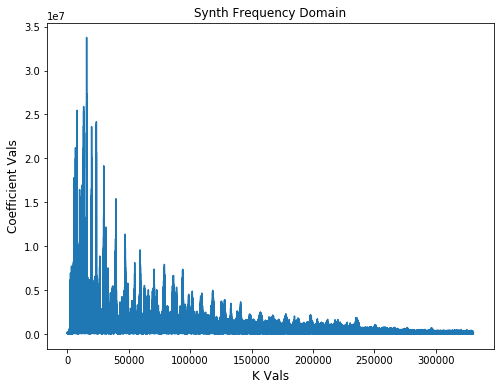

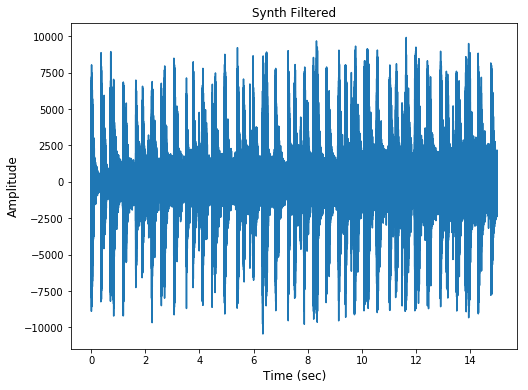

In [138]:
# Synth Analysis: Slight Filtering

# View the freq domain of the synth
fft_synth = np.fft.rfft(synth_data)
plot((8,6), "K Vals", "Coefficient Vals", 12, 'linear', fft_synth)
plt.title('Synth Frequency Domain', fontsize=12)

# 20000 beyond are very low coefficients
fft_synth[100000:len(fft_synth)] = 0

# Revert to time domain
synth_filtered = np.fft.irfft(fft_synth)
plot((8,6), "Time (sec)", "Amplitude", 12, 'linear', t_synth, synth_filtered)
plt.title('Synth Filtered', fontsize=12)

# Playback filtered audio
# Note: it sounds compressed
ipd.Audio(synth_filtered, rate=synth_fs)

As is clear, different instruments and sounds have different waveplots. The way in which the instrument is played or the sound is delivered has an inherent effect on these waveplots as well. Compared to the piano and vocals, the other sounds were more closely packed together. Of particular note is the synth, however. Being a digital sound, it is a very controlled, symmetric waveplot.

However, these waveplots give very little information as to what the actual instrument sounds like. To visualize sound -- so to speak -- pictured below are the spectrograms of the various instruments and sounds, as well as their filtered counterparts.

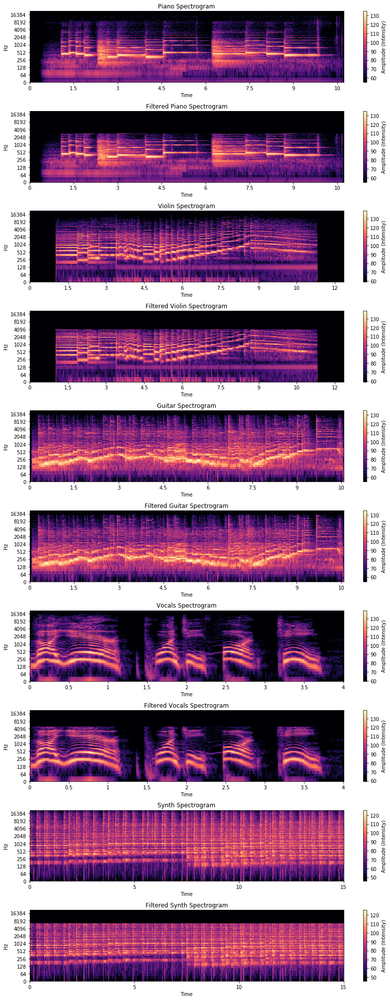

In [139]:
plt.figure(figsize=(12,28))

specPlot(piano_data, piano_fs, 10, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'Piano Spectrogram')
specPlot(piano_filtered, piano_fs, 10, 1, 2, 'time', 'log', 'Amplitude (Intensity)', 'Filtered Piano Spectrogram')
specPlot(violin_data, violin_fs, 10, 1, 3, 'time', 'log', 'Amplitude (Intensity)', 'Violin Spectrogram')
specPlot(violin_filtered, violin_fs, 10, 1, 4, 'time', 'log', 'Amplitude (Intensity)', 'Filtered Violin Spectrogram')
specPlot(guitar_data, guitar_fs, 10, 1, 5, 'time', 'log', 'Amplitude (Intensity)', 'Guitar Spectrogram')
specPlot(guitar_filtered, guitar_fs, 10, 1, 6, 'time', 'log', 'Amplitude (Intensity)', 'Filtered Guitar Spectrogram')
specPlot(mvocal_data, mvocal_fs, 10, 1, 7, 'time', 'log', 'Amplitude (Intensity)', 'Vocals Spectrogram')
specPlot(mvocal_filtered, mvocal_fs, 10, 1, 8, 'time', 'log', 'Amplitude (Intensity)', 'Filtered Vocals Spectrogram')
specPlot(synth_data, synth_fs, 10, 1, 9, 'time', 'log', 'Amplitude (Intensity)', 'Synth Spectrogram')
specPlot(synth_filtered, synth_fs, 10, 1, 10, 'time', 'log', 'Amplitude (Intensity)', 'Filtered Synth Spectrogram')

# Results: Part 1
Although Fourier Filtering looked as if it was doing nothing, the spectrograms give a different picture. Filtering simply removed the less wanted frequencies from the audio signal. Most of the important frequencies for the majority of the audio files are below 512 Hz, so chopping off the unimportant frequencies towards the top of the spectrogram doesn't necessarily ruin the important sounds, but rather it limits the "depth" of the sound, hence the muffled audio.

Additionally, waveplots didn't really provide much insight as to what the audio sounded like. With spectrograms, however, the dips and rises in frequency are clearly visible, as is the strength of a particular note. The piano spectrograms look as if someone is pressing keys at a set interval, causing sound to propagate. The guitar and violin spectrograms are much more unified, likely due to string instruments' sound oscillating and persisting longer (perceivably) in the air.

Now, the vocals are very interesting. Speech is caused by the lungs modulating air outwards, vibrating our voice box and causing changes in the air, resonating outwards. Humans aren't computers and can't necessarily control their voice perfectly, so it makes sense that vocals would appear rounded in the spectrogram, since we're constantly modulating the air to speak.

The synth is the exact opposite of the vocals: very straight and uniform, as expected from a digital sound. The shift in tone at the 7 second mark is clearly visible, however. The sound is constantly rising in this audio, except when it shifts lower for just a moment and then continues its upward trend.

# Methodology: Part 2
The focus of this part was to take the gravitational waves data from LIGO and convert it to some sort of audio. This data is originally viewed as time vs strain. Now, the original data, plotted below, spans a period 0.2 ~ 0.21 seconds. This was elongated by creating a repeating signal, and done so because 0.2 seconds was not enough to properly listen to the audio. It was lengthed by 20 times to get approximatley 4 seconds of audio.

The sampling rate used was 16386. The original dataset had 3441 original points, so the sampling rate was derived from dividing the number of points by the timespan: $\frac{3441}{0.21}=$ 16386.

Along with the original data and lengthened data/audio, pictured below are filtered signals. The data from LIGO is already quite clean, so filtering just a little bit has no noticeable effect, but filtering significantly does provide a smoother graph, albeit less accurate. Additionally, pictured with the audio are spectrograms, for another type of visualization of the gravitaional waves as audio.

For validating what the audio sounds like, hypothetically, it is expected to sound like what the LIGO wave looks like: just some wobbling frequency. 

The Hanford H1 data is shown first, and then the Livingston L1 data.

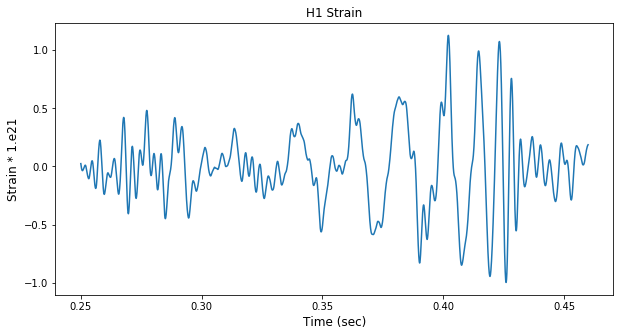

In [140]:
# Load the data from Hanford
H1_sec, H1_strain = np.loadtxt('H1_Strain.txt', unpack=True)

# Plot the gravitational waves signal
plot((10,5), 'Time (sec)', 'Strain * 1.e21', 12, 'linear', H1_sec, H1_strain)
plt.title('H1 Strain', fontsize=12)

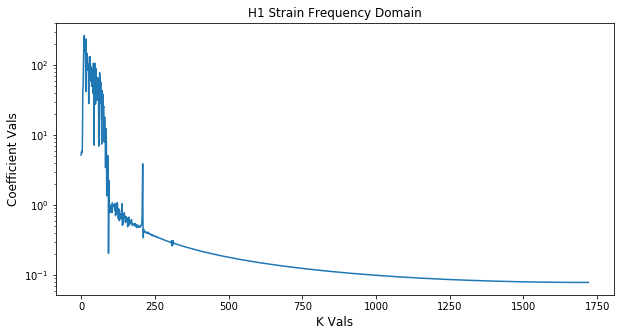

In [141]:
# View the data in the frequency domain
fft_H1 = np.fft.rfft(H1_strain)
plot((10,5), 'K Vals', 'Coefficient Vals', 12, 'log', fft_H1)
plt.title('H1 Strain Frequency Domain')

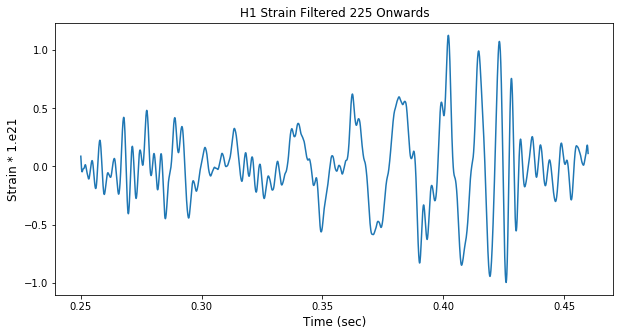

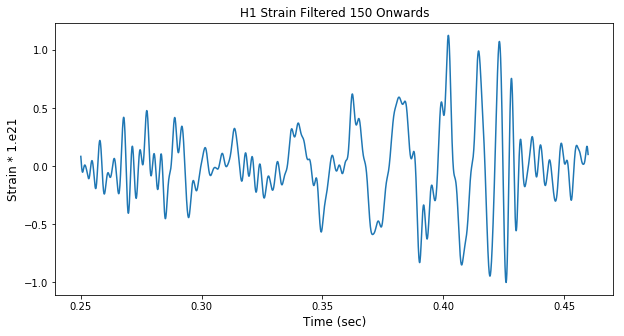

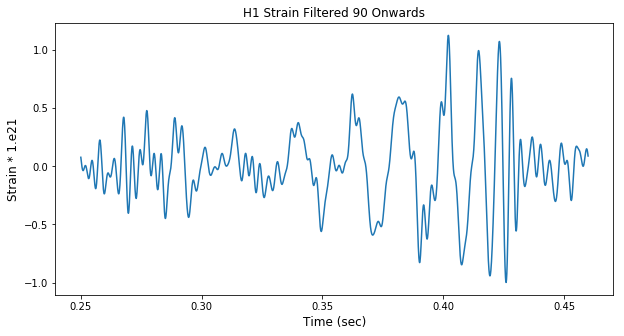

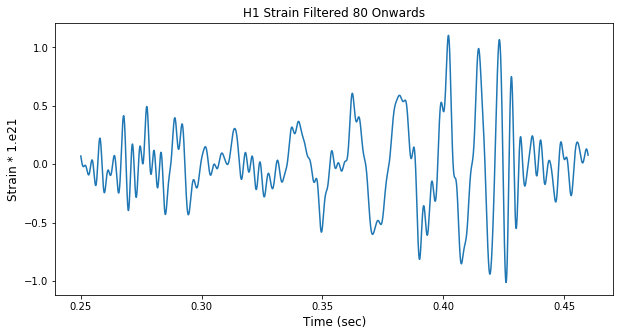

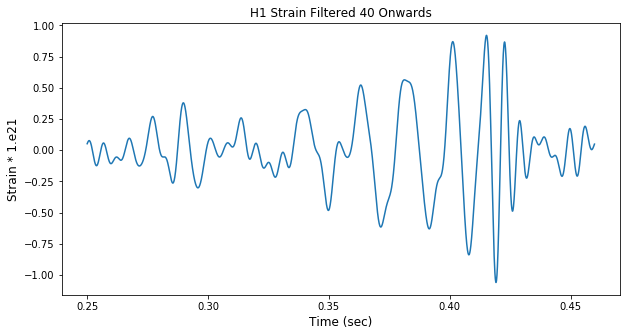

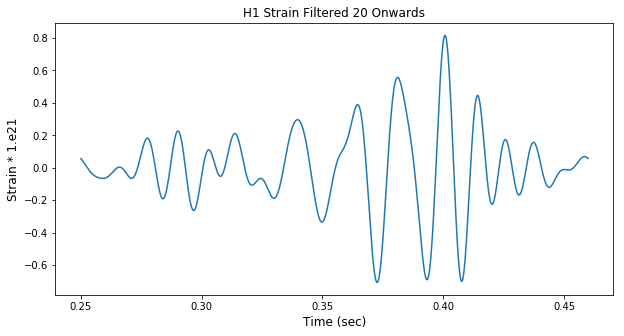

In [142]:
H1a = cutoffSmooth(fft_H1, 225, H1_sec)
plt.title('H1 Strain Filtered 225 Onwards')
H1b = cutoffSmooth(fft_H1, 150, H1_sec)
plt.title('H1 Strain Filtered 150 Onwards')
H1c = cutoffSmooth(fft_H1, 90, H1_sec)
plt.title('H1 Strain Filtered 90 Onwards')
H1d = cutoffSmooth(fft_H1, 80, H1_sec)
plt.title('H1 Strain Filtered 80 Onwards')
H1e = cutoffSmooth(fft_H1, 40, H1_sec)
plt.title('H1 Strain Filtered 40 Onwards')
H1f = cutoffSmooth(fft_H1, 20, H1_sec)
plt.title('H1 Strain Filtered 20 Onwards')

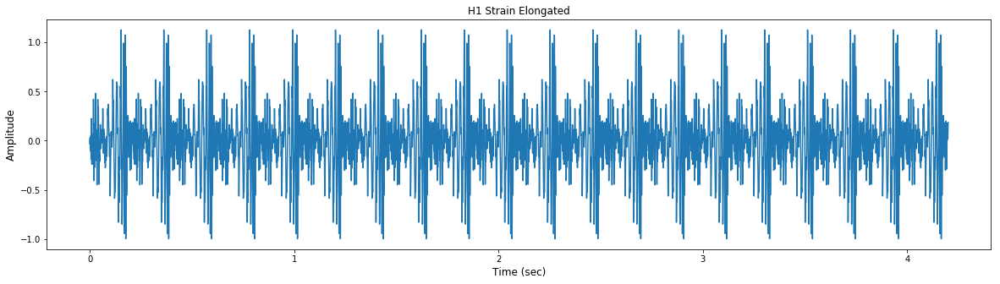

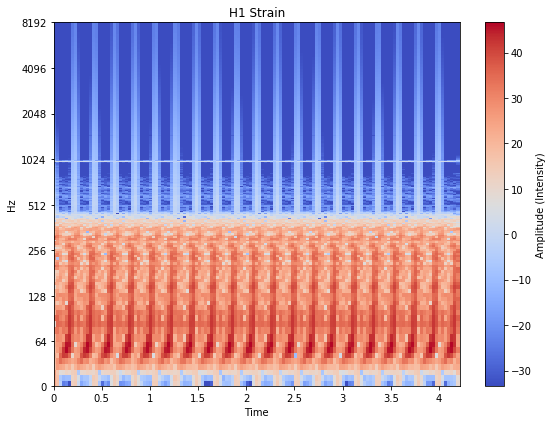

In [143]:
H1_fs, H1_strain_elong = listenGrav(H1_strain)
plt.title('H1 Strain Elongated')
plt.figure(figsize=(8,6))
specPlot(H1_strain_elong, H1_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'H1 Strain')

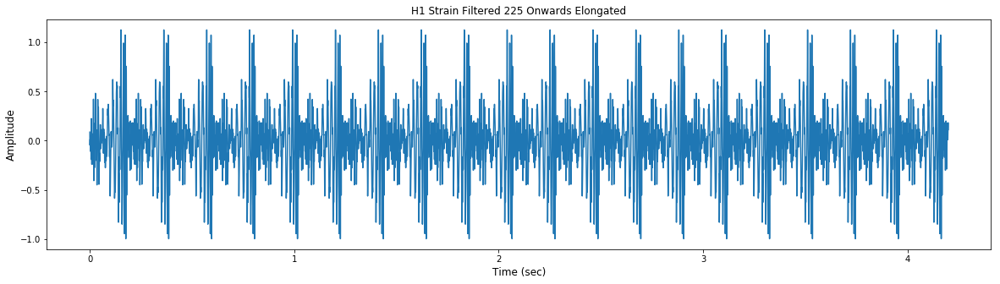

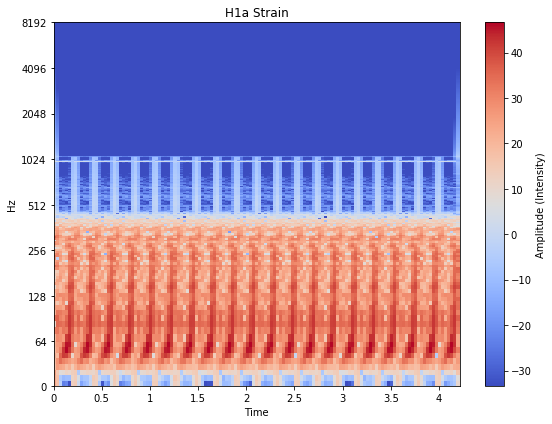

In [144]:
H1_fs, H1a_strain_elong = listenGrav(H1a)
plt.title('H1 Strain Filtered 225 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(H1a_strain_elong, H1_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'H1a Strain')

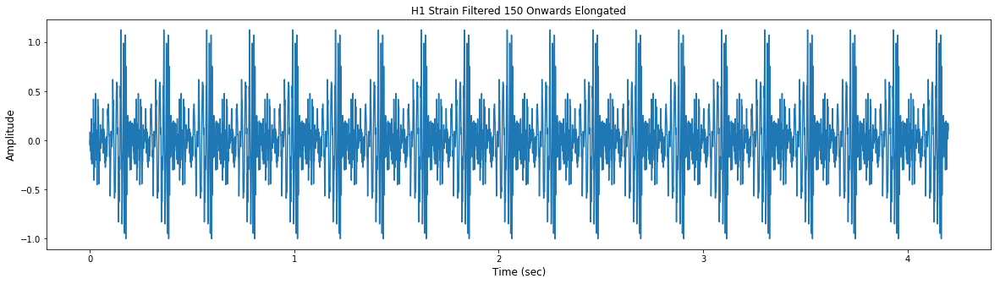

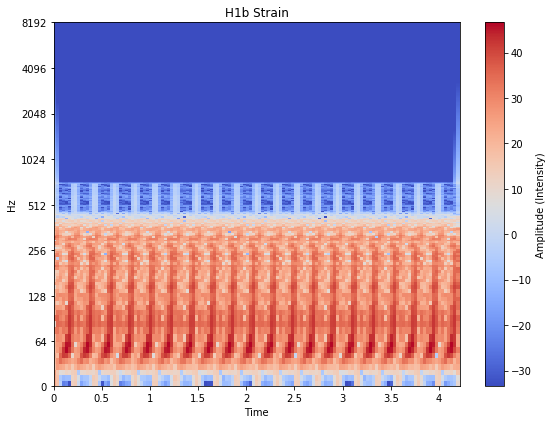

In [145]:
H1_fs, H1b_strain_elong = listenGrav(H1b)
plt.title('H1 Strain Filtered 150 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(H1b_strain_elong, H1_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'H1b Strain')

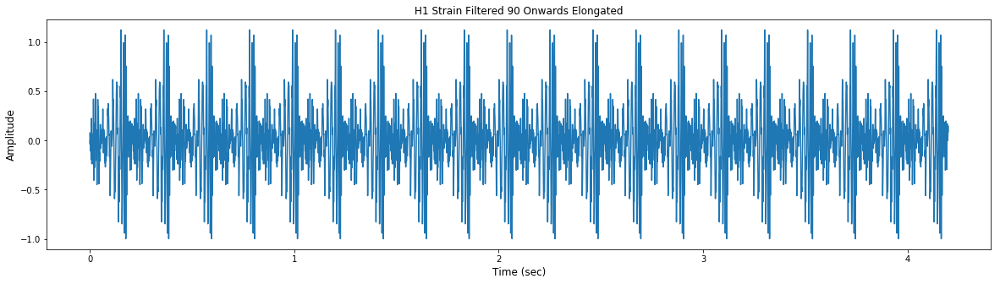

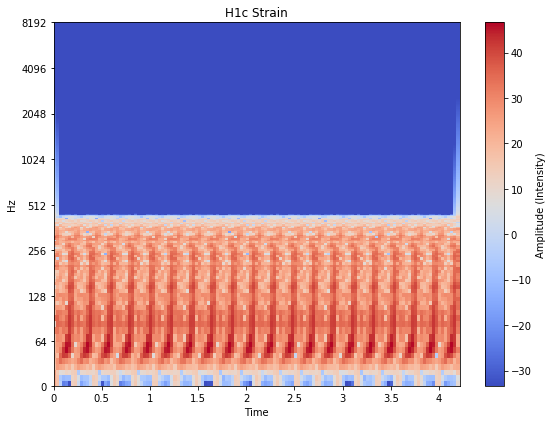

In [146]:
H1_fs, H1c_strain_elong = listenGrav(H1c)
plt.title('H1 Strain Filtered 90 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(H1c_strain_elong, H1_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'H1c Strain')

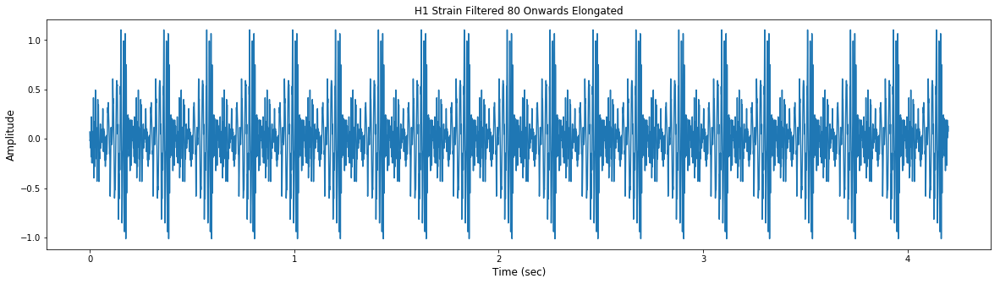

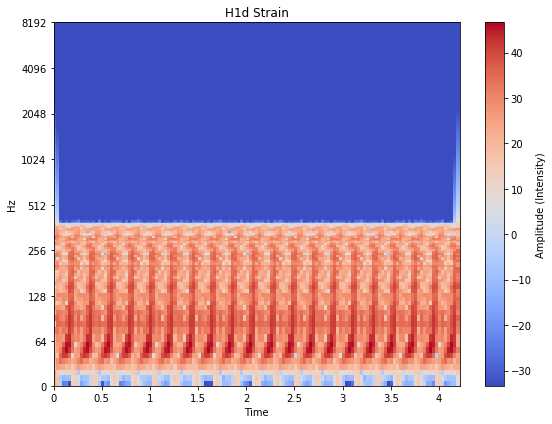

In [147]:
H1_fs, H1d_strain_elong = listenGrav(H1d)
plt.title('H1 Strain Filtered 80 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(H1d_strain_elong, H1_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'H1d Strain')

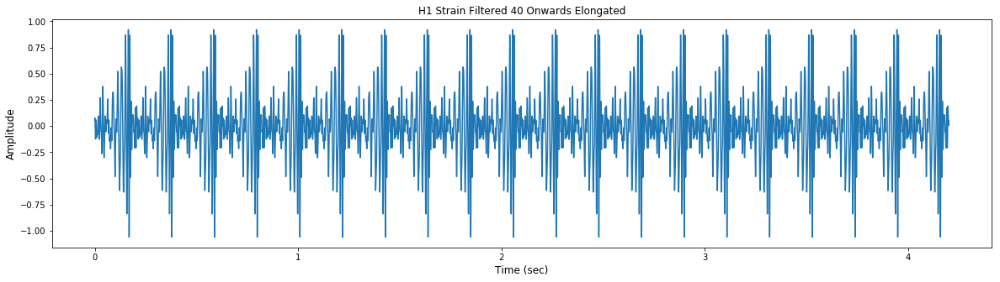

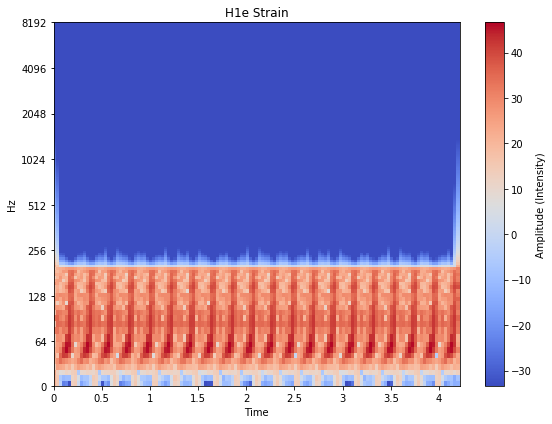

In [148]:
H1_fs, H1e_strain_elong = listenGrav(H1e)
plt.title('H1 Strain Filtered 40 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(H1e_strain_elong, H1_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'H1e Strain')

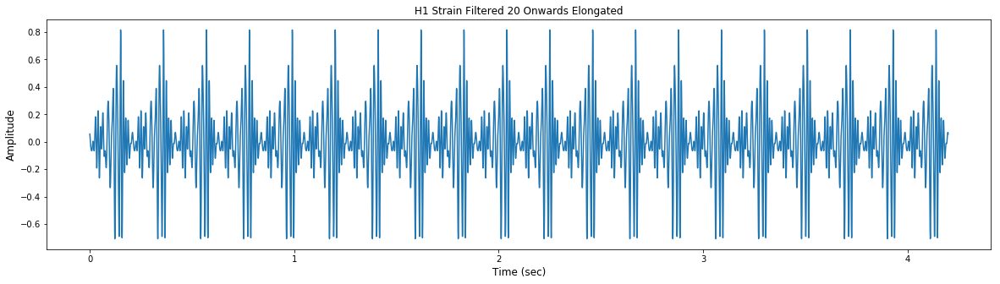

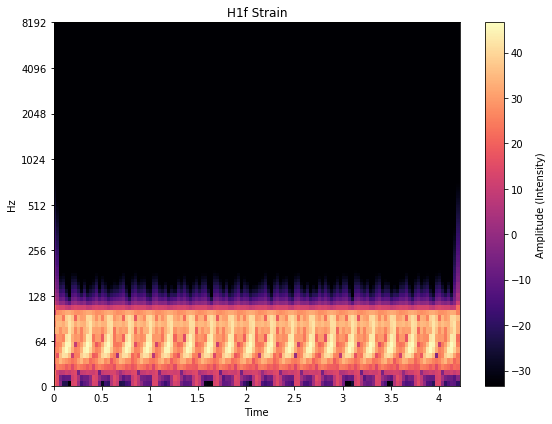

In [149]:
H1_fs, H1f_strain_elong = listenGrav(H1f)
plt.title('H1 Strain Filtered 20 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(H1f_strain_elong, H1_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'H1f Strain')

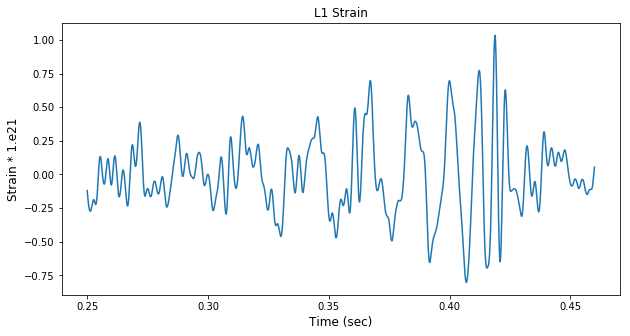

In [183]:
%matplotlib inline
# Load the data from Louisiana
L1_sec, L1_strain = np.loadtxt('L1_Strain.txt', unpack=True)

# Plot the gravitational waves signal
plot((10,5), 'Time (sec)', 'Strain * 1.e21', 12, 'linear', L1_sec, L1_strain)
plt.title('L1 Strain')

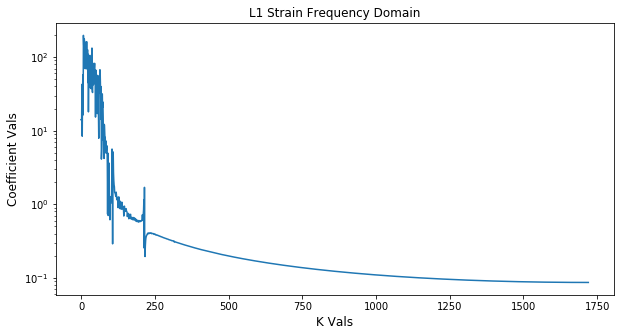

In [184]:
# View the data in the frequency domain
fft_L1 = np.fft.rfft(L1_strain)
plot((10,5), 'K Vals', 'Coefficient Vals', 12, 'log', fft_L1)
plt.title('L1 Strain Frequency Domain')

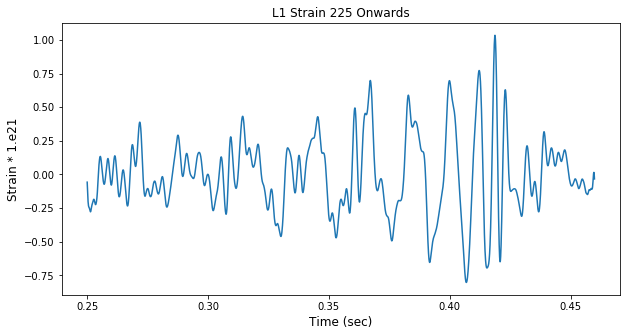

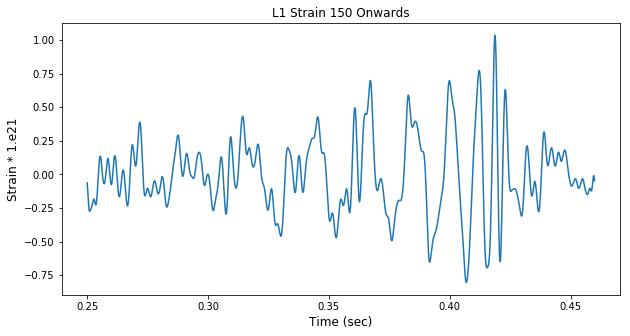

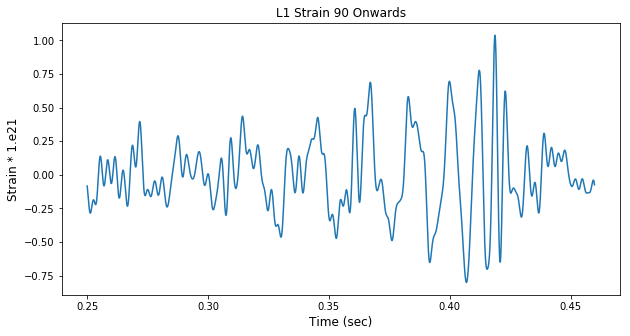

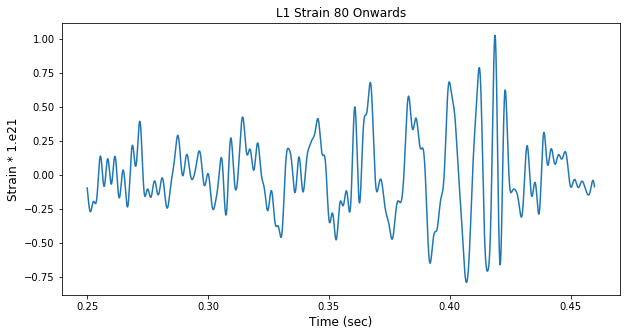

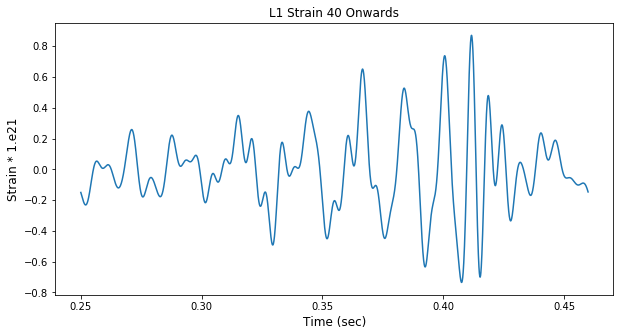

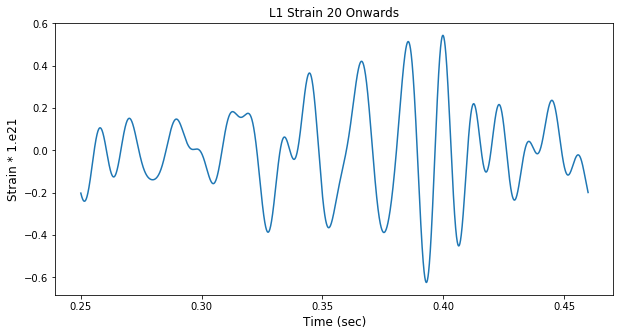

In [185]:
L1a = cutoffSmooth(fft_L1, 225, L1_sec)
plt.title("L1 Strain 225 Onwards")
L1b = cutoffSmooth(fft_L1, 150, L1_sec)
plt.title("L1 Strain 150 Onwards")
L1c = cutoffSmooth(fft_L1, 90, L1_sec)
plt.title("L1 Strain 90 Onwards")
L1d = cutoffSmooth(fft_L1, 80, L1_sec)
plt.title("L1 Strain 80 Onwards")
L1e = cutoffSmooth(fft_L1, 40, L1_sec)
plt.title("L1 Strain 40 Onwards")
L1f = cutoffSmooth(fft_L1, 20, L1_sec)
plt.title("L1 Strain 20 Onwards")

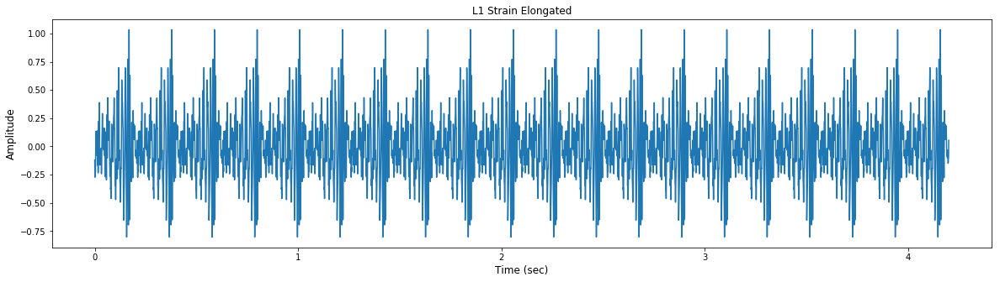

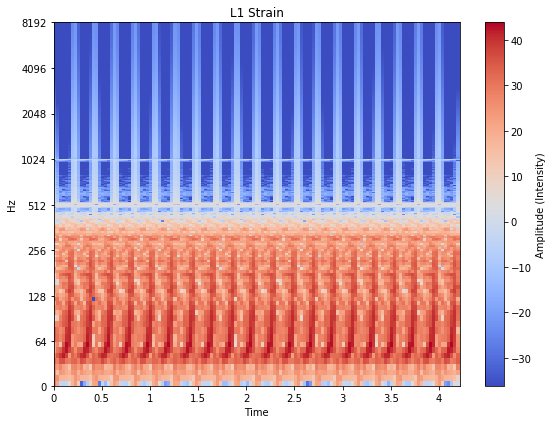

In [153]:
L1_fs, L1_strain_elong = listenGrav(L1_strain)
plt.title('L1 Strain Elongated')
plt.figure(figsize=(8,6))
specPlot(L1_strain_elong, L1_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'L1 Strain')

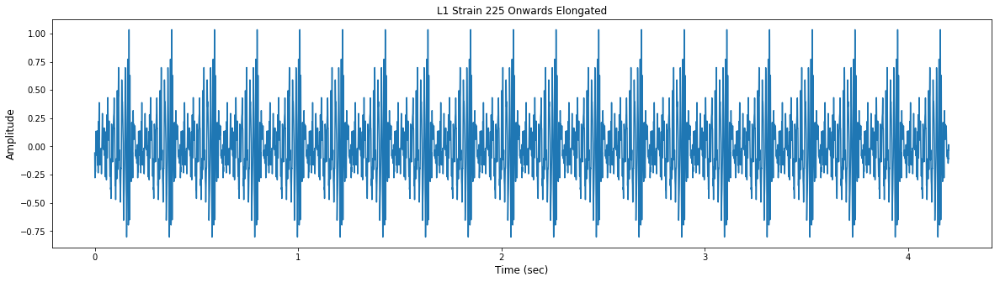

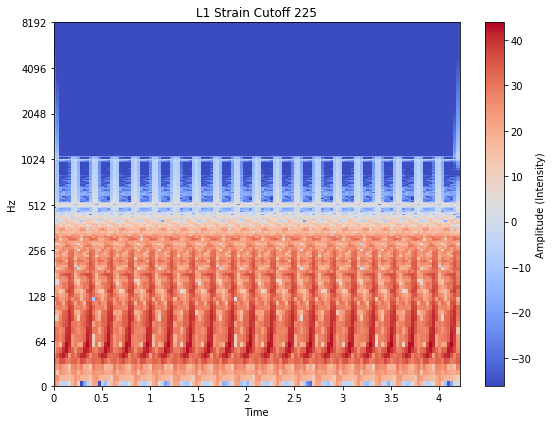

In [154]:
L1a_fs, L1a_elong = listenGrav(L1a)
plt.title('L1 Strain 225 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(L1a_elong, L1a_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'L1 Strain Cutoff 225')

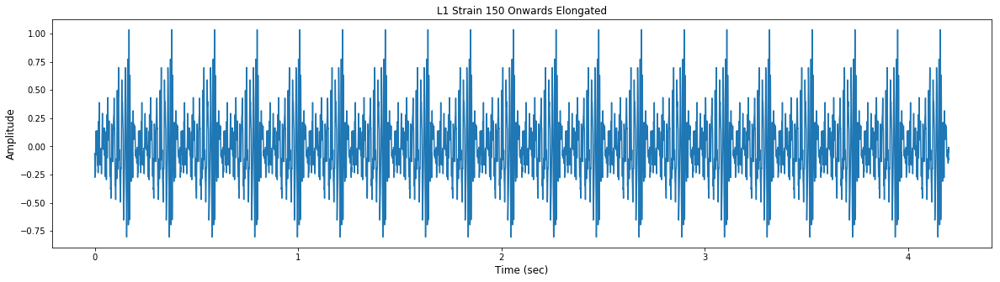

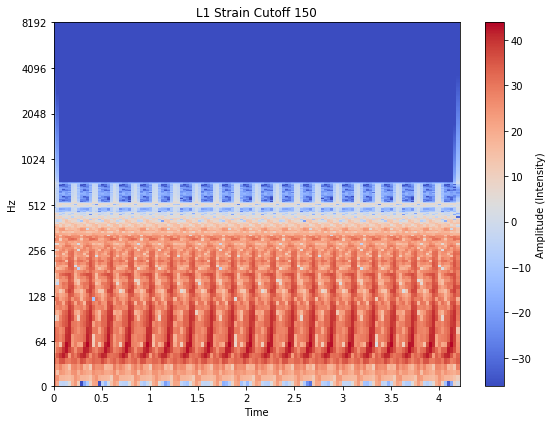

In [155]:
L1b_fs, L1b_elong = listenGrav(L1b)
plt.title('L1 Strain 150 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(L1b_elong, L1b_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'L1 Strain Cutoff 150')

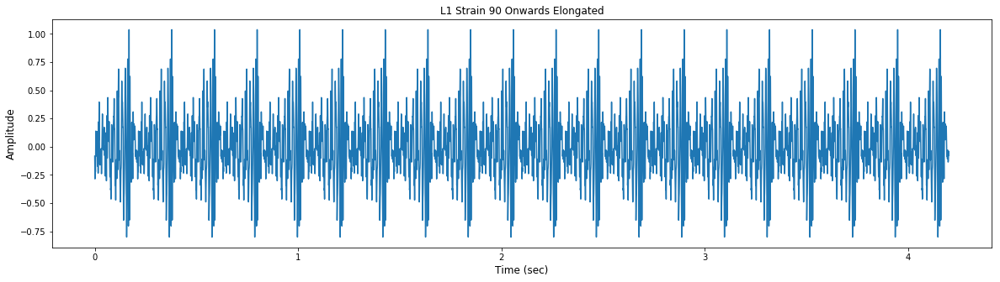

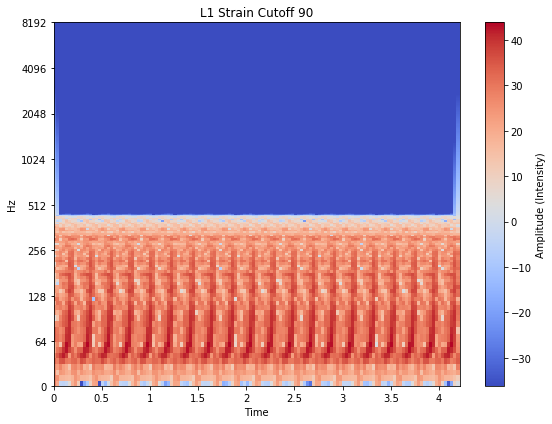

In [156]:
L1c_fs, L1c_elong = listenGrav(L1c)
plt.title('L1 Strain 90 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(L1c_elong, L1c_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'L1 Strain Cutoff 90')

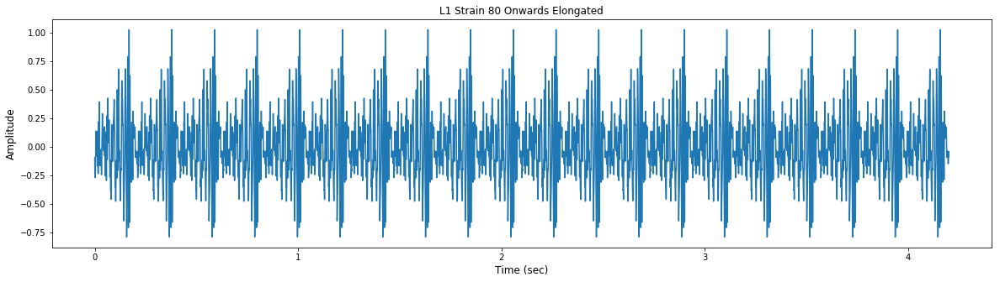

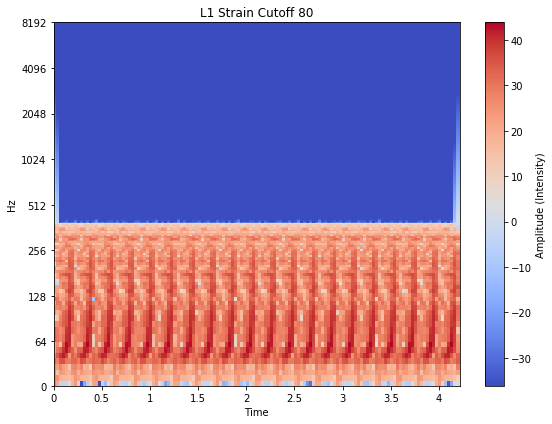

In [157]:
L1d_fs, L1d_elong = listenGrav(L1d)
plt.title('L1 Strain 80 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(L1d_elong, L1d_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'L1 Strain Cutoff 80')

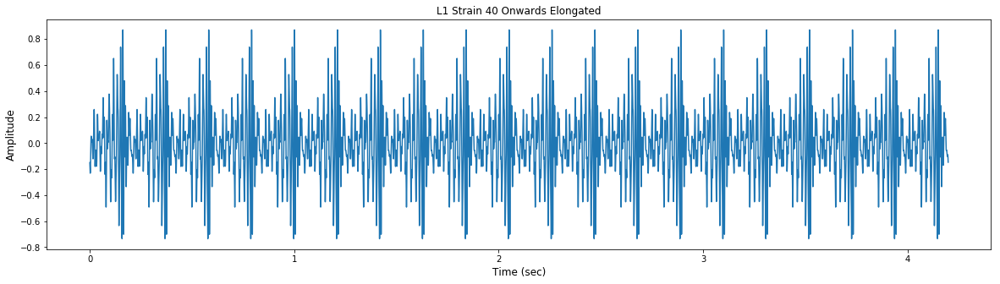

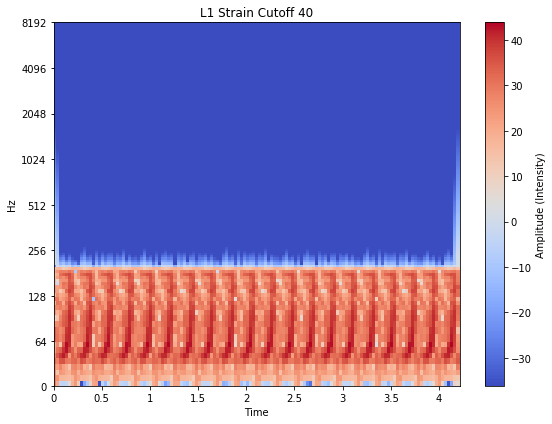

In [158]:
L1e_fs, L1e_elong = listenGrav(L1e)
plt.title('L1 Strain 40 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(L1e_elong, L1e_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'L1 Strain Cutoff 40')

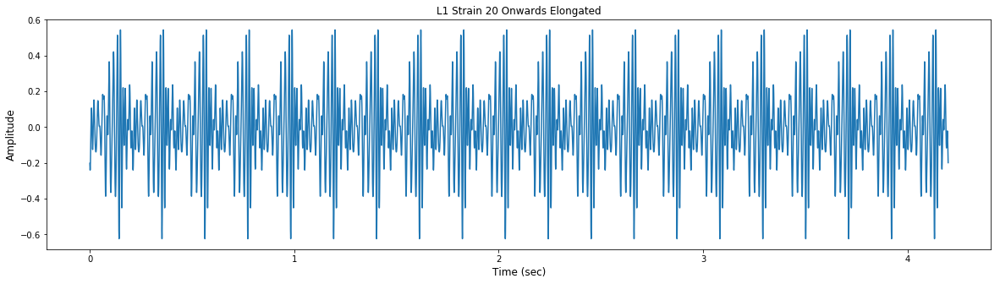

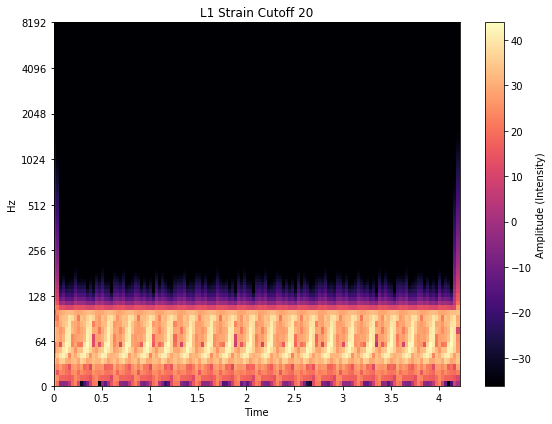

In [159]:
L1f_fs, L1f_elong = listenGrav(L1f)
plt.title('L1 Strain 20 Onwards Elongated')
plt.figure(figsize=(8,6))
specPlot(L1f_elong, L1f_fs, 1, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'L1 Strain Cutoff 20')

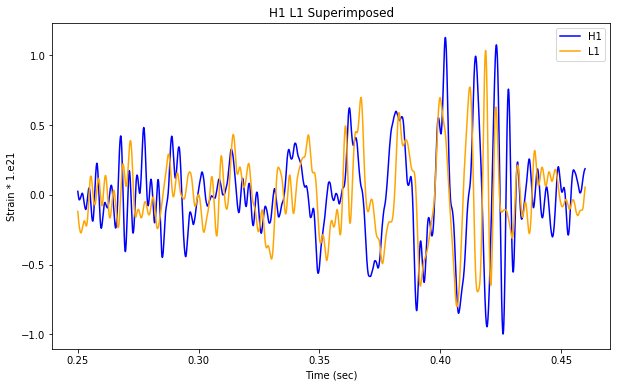

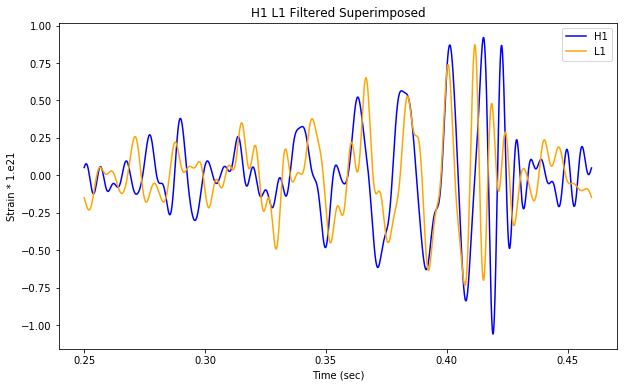

In [160]:
# Plot both H1 and L1 on same graph

plt.figure(figsize=(10,6))
plt.plot(H1_sec, H1_strain, 'blue', label='H1')
plt.plot(H1_sec, L1_strain, 'orange', label='L1')
plt.legend(loc='upper right')
plt.xlabel('Time (sec)')
plt.ylabel('Strain * 1.e21')
plt.title('H1 L1 Superimposed')
plt.show()

plt.figure(figsize=(10,6))
plt.plot(H1_sec[0:len(H1_sec)-1], H1e, 'blue', label='H1')
plt.plot(H1_sec[0:len(H1_sec)-1], L1e, 'orange', label='L1')
plt.legend(loc='upper right')
plt.xlabel('Time (sec)')
plt.ylabel('Strain * 1.e21')
plt.title('H1 L1 Filtered Superimposed')
plt.show()

# Results: Part 2
Now, although there are a lot of graphs and plots above, these images are mainly depicting just a few things: the effect Fourier Filtering has on this data, and what gravitional waves sound like as audio. 

Listening to the audio, it is clear that it sounds like a wobbling frequency, as expected. Specifically, its wobbling at a low frequency, as depicted by the spectrogram plots where the intensity of the audio is much greater towards the bottom of the spectrum than the top. Additionally, the less impotant frequencies removed by the Fourier Transforms are the higher frequencies towards the top of the spectrum, with a blue color corresponding to a lesser intensity.

As for filtering the actual signal, there seems to be very little purpose in doing so here, simply because the data isn't jumping all over the place. However, there could be some merit to using Fourier filtering here to smooth the data out for a person looking at a large amount of this type of data and who is more interested in discovering the trends or patterns of the curves.

Pictured right above are the H1 and L1 strain signals superimposed atop one another. Here, they are quite difficult to really compare to each other, though the trend is apparent. A filtered version of them as shown right underneath provides an easier plot to look at for really comparing the two signals and noting the similarities and differences.

Of course, both signals are not the same because there was a time delay between one LIGO detecting gravitaional waves and the other detecting them, among other factors.

# Methodology: Part 3
The entire project culminates to this part, where the Fourier Transform is used to classify audio. Several different attempts were made to create a classifier, but only the final is presented here, with a brief overview of the others.

Initially, a machine learning approach using scikit was attempted. Mainly due to a lack of experience with machine learning libraries and techniques, this attempt made it only as far as to classify different pitches in audio using kmeans clustering. Though interesting in and of itself, a method to compare datasets to some learned data failed to come about.

Then, the focus shifted over to try and force a learned dataset and compare the difference in values with a new dataset. In this scenario, the A4, F3, and F4 signals were merged together into one audio file and their respective pitches were classified. This didn't work for two reasons:
1. What was perceived to be usable data simply wasn't. Combining the signals together cannot yield a proper, baseline dataset because the majority pitch may change. Or, it may not, and either way you have no way of getting clear data. Using this method is "noisy".
2. Again, likely due to a lack of working with this library, there was no apparent way to tell which pitch was classified as what from the kmeans clustering outputs

As such, the only valuable side-effect of attempting this method was gaining experience with scikit, and making pretty plots with plotly.

The previous method did have one good merit, however. That is, the idea of figuring out the difference between two datasets. Thus, instead of applying it through a machine learning approach, creating a "learned dataset" of sorts was done manually. For each of A4, F3, and F4 .wav files, their respective frequency domains were scrutinized in conjunction with their spectrogram plots in order to find the peaks corresponding to their baseline frequency. From a quick Google search, A4 sits at 440 Hz, F3 at 175 Hz, and F4 at 350 HZ. All peaks except the tallest were removed from the frequency domain and then the spectrogram was viewed again, yielding that the peak left was indeed the peak corresponding to the baseline frequencies.

For some reason, however, this didn't apply to the .wav file corresponding to F4. This is likely due to some variance in that audio file that caused 2 other, larger peaks to form. Nonetheless, the peak corresponding to the baseline frequency for F4 was found.

An average was taken for each of the peaks with respect to their location -- offsets of a few hundred on both sides. Now, in order to determine whether a given input .wav file is A4, F3, or F4, the file is matched to the musical note with the closest peak to its maximal peak.

Below is the method in which the averages were computed; simply by hand after using %matplotlib notebook to look closer into the frequency domain.

<IPython.core.display.Javascript object>


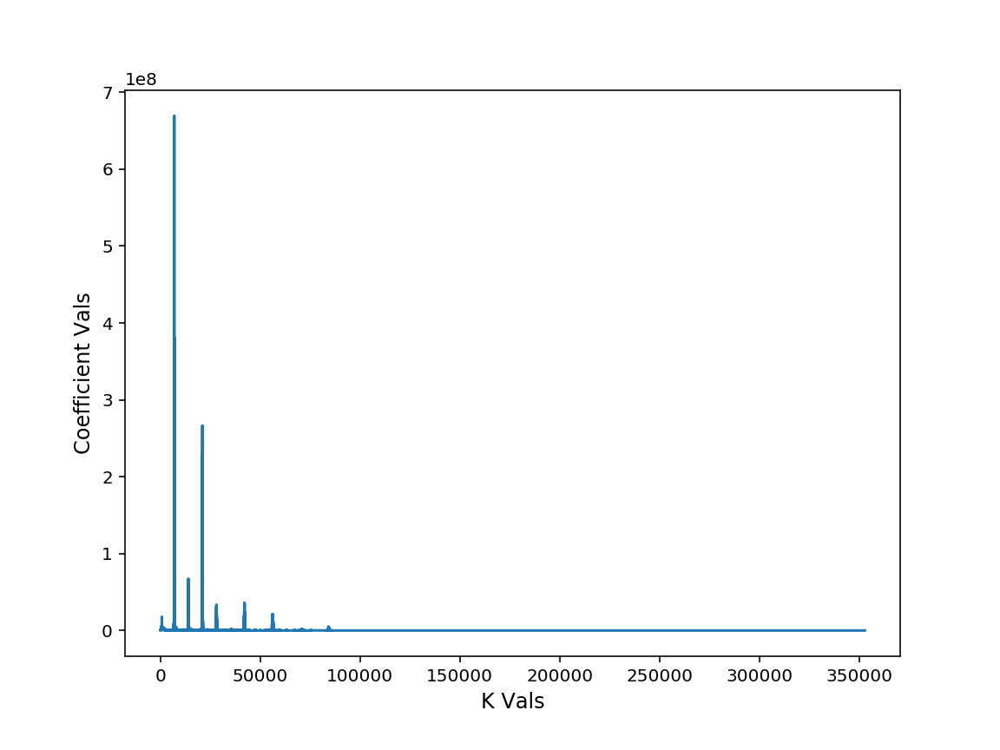

<IPython.core.display.Javascript object>


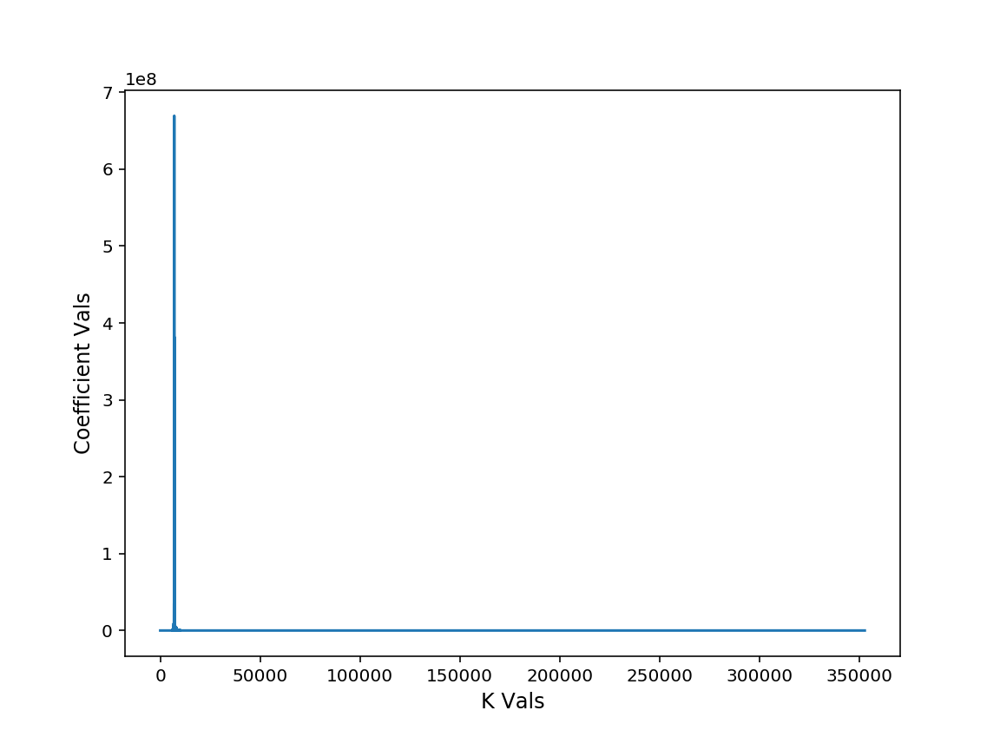

<IPython.core.display.Javascript object>


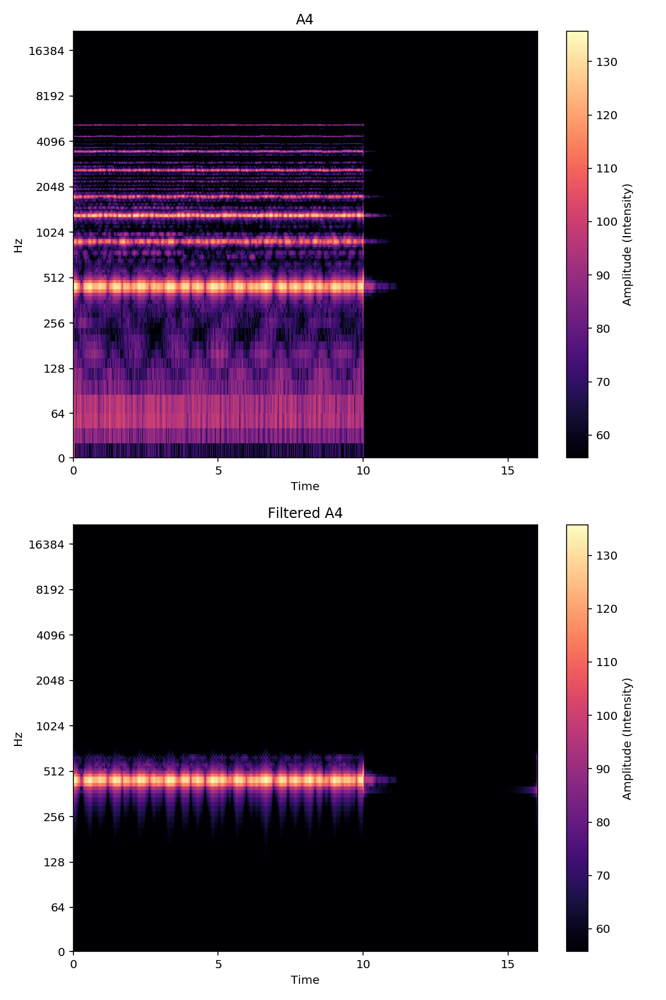

In [180]:
%matplotlib notebook

A4_fs, A4_data = wavfile.read('A4_PopOrgan.wav')
A4_data = A4_data[:,0]

t_A4 = np.linspace(0, len(A4_data)/A4_fs, len(A4_data))

fft_A4 = np.fft.rfft(A4_data)
plot((8,6), 'K Vals', 'Coefficient Vals', 12, 'linear', fft_A4, None)
fft_A4[0:6000] = 0
fft_A4[10000:len(fft_A4)] = 0
plot((8,6), 'K Vals', 'Coefficient Vals', 12, 'linear', fft_A4, None)
invA4 = np.fft.irfft(fft_A4)

plt.figure(figsize=(8,12))
specPlot(A4_data, A4_fs, 2, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'A4')
specPlot(invA4, A4_fs, 2, 1, 2, 'time', 'log', 'Amplitude (Intensity)', 'Filtered A4')

ipd.display(ipd.Audio(invA4, rate=A4_fs))

<IPython.core.display.Javascript object>


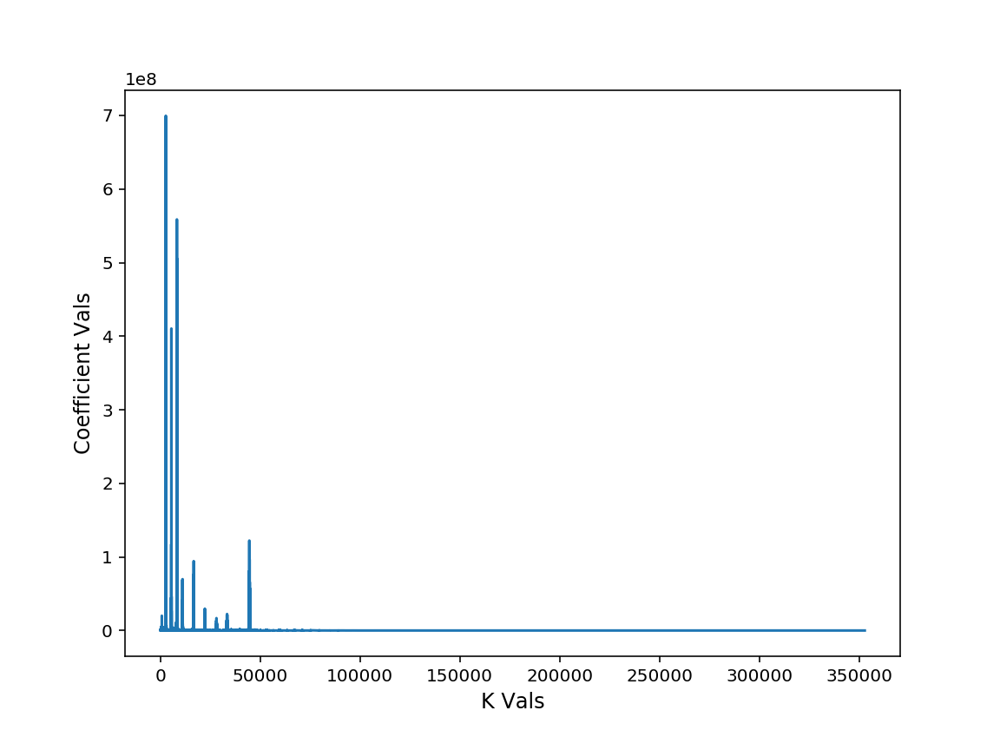

<IPython.core.display.Javascript object>


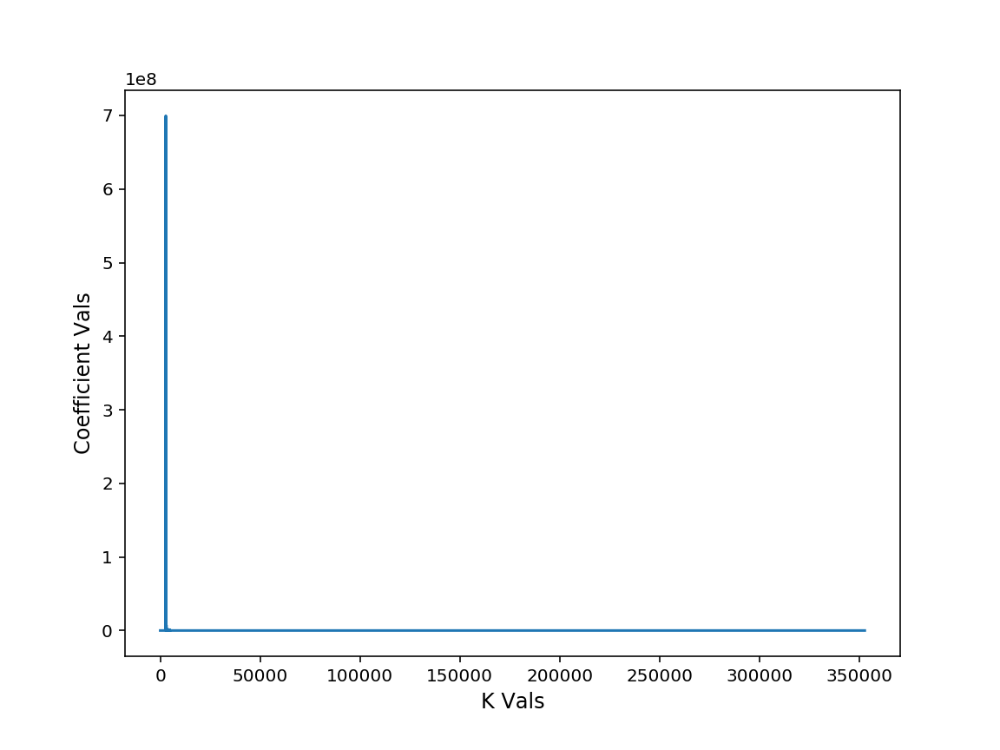

<IPython.core.display.Javascript object>


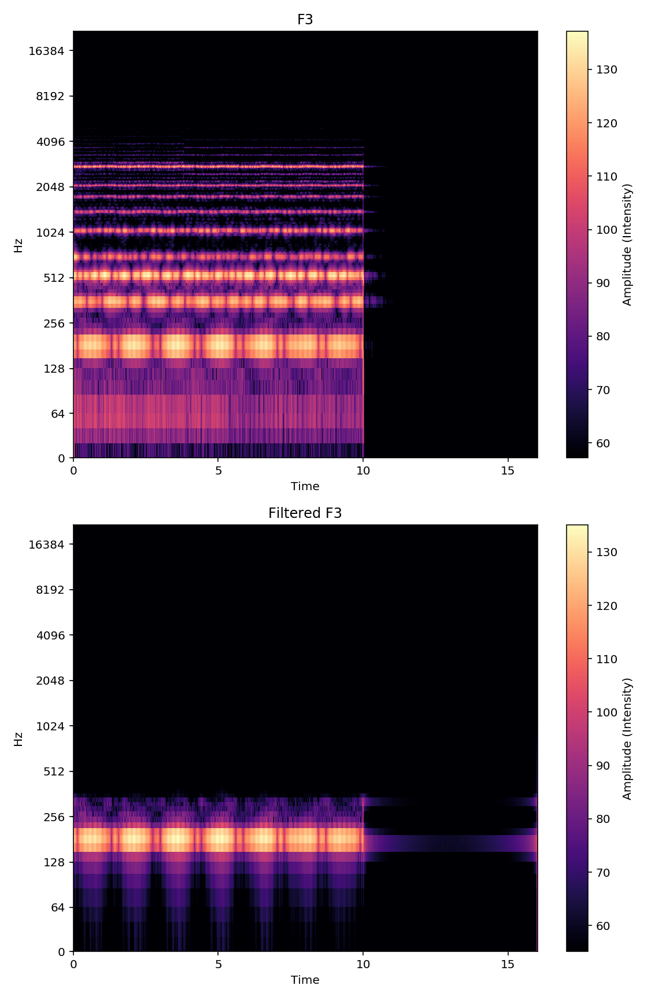

In [181]:
%matplotlib notebook

F3_fs, F3_data = wavfile.read('F3_PopOrgan.wav')
F3_data = F3_data[:,0]

fft_F3 = np.fft.rfft(F3_data)
plot((8,6), 'K Vals', 'Coefficient Vals', 12, 'linear', fft_F3, None)
fft_F3[0:2600] = 0
fft_F3[5000:len(fft_F3)] = 0
plot((8,6), 'K Vals', 'Coefficient Vals', 12, 'linear', fft_F3, None)
invF3 = np.fft.irfft(fft_F3)

t_F3 = np.linspace(0, len(F3_data)/F3_fs, len(F3_data))

plt.figure(figsize=(8,12))
specPlot(F3_data, F3_fs, 2, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'F3')
specPlot(invF3, F3_fs, 2, 1, 2, 'time', 'log', 'Amplitude (Intensity)', 'Filtered F3')

ipd.display(ipd.Audio(invF3, rate=F3_fs))

<IPython.core.display.Javascript object>


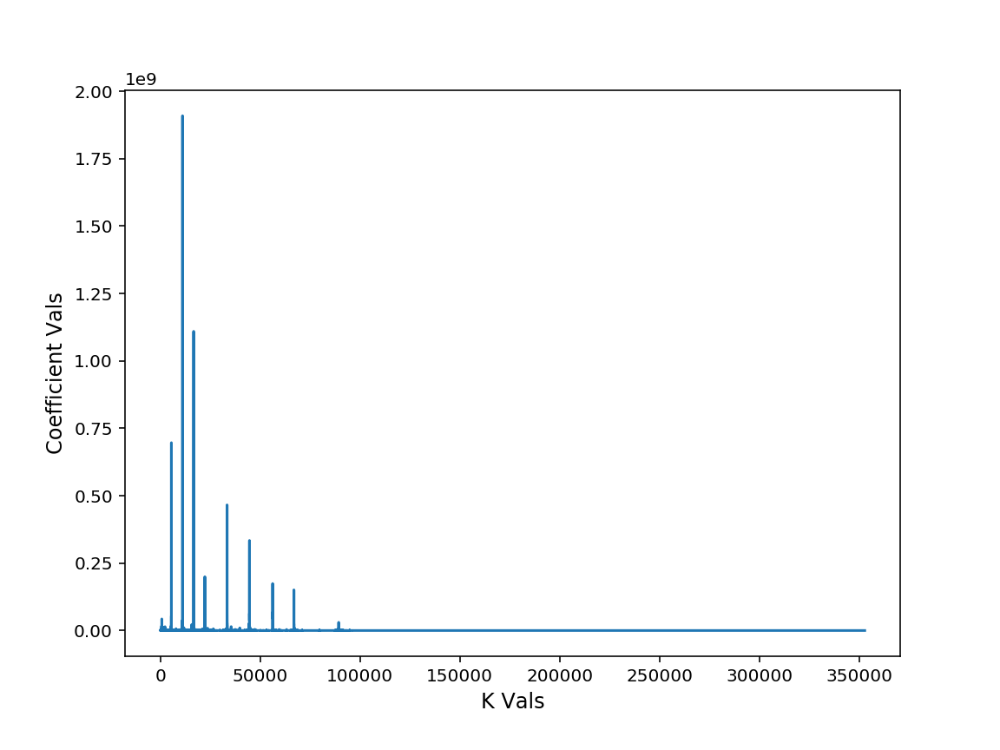

<IPython.core.display.Javascript object>


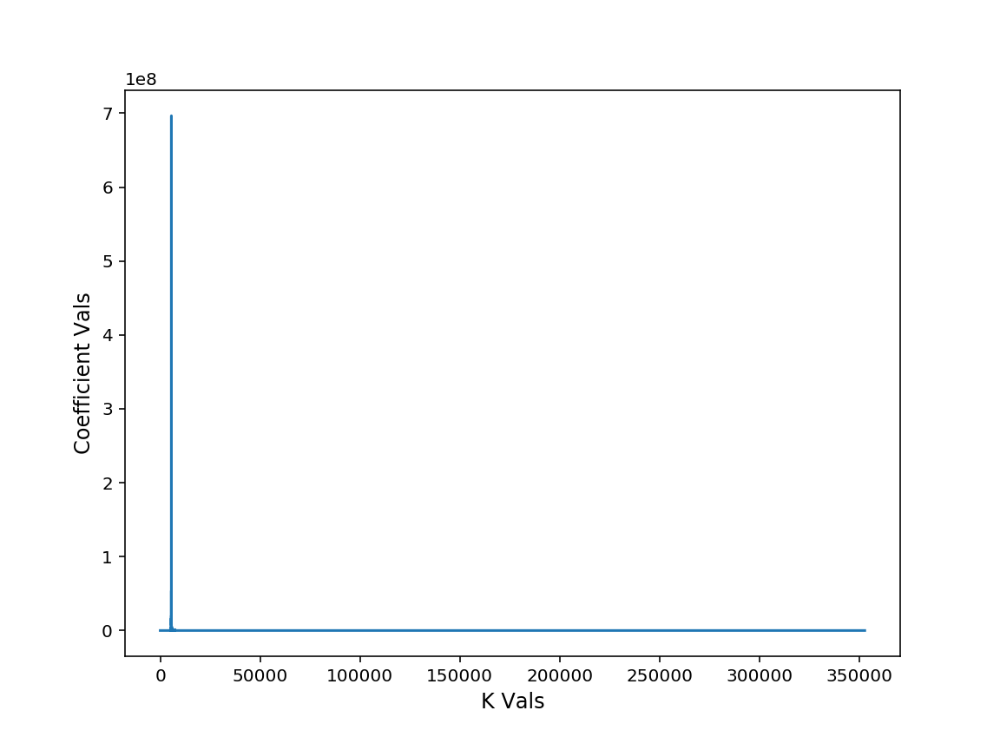

<IPython.core.display.Javascript object>


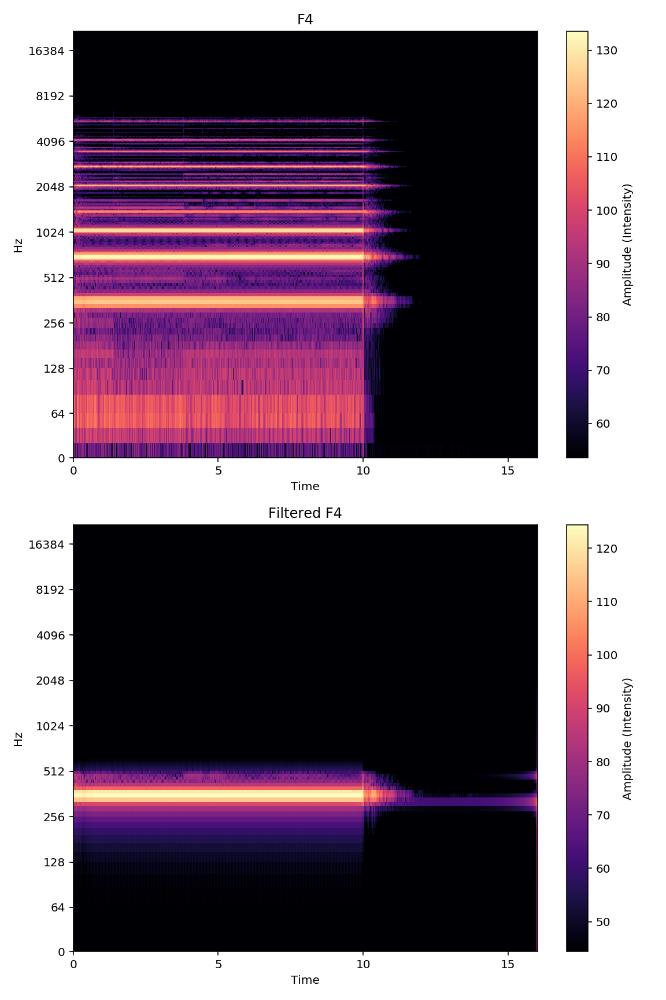

In [163]:
%matplotlib notebook

F4_fs, F4_data = wavfile.read('F4_CathedralOrgan.wav')
F4_data = F4_data[:,0]

t_F4 = np.linspace(0, len(F4_data)/F4_fs, len(F4_data))

fft_F4 = np.fft.rfft(F4_data)
plot((8,6), 'K Vals', 'Coefficient Vals', 12, 'linear', fft_F4, None)
fft_F4[0:5000] = 0
fft_F4[7500:len(fft_F4)] = 0
plot((8,6), 'K Vals', 'Coefficient Vals', 12, 'linear', fft_F4, None)
invF4 = np.fft.irfft(fft_F4)

plt.figure(figsize=(8,12))
specPlot(F4_data, F4_fs, 2, 1, 1, 'time', 'log', 'Amplitude (Intensity)', 'F4')
specPlot(invF4, F4_fs, 2, 1, 2, 'time', 'log', 'Amplitude (Intensity)', 'Filtered F4')

ipd.display(ipd.Audio(invF4, rate=F4_fs))

## CLASSIFICATION RUNNING BELOW

This audio file is classified as an F4 note


<IPython.core.display.Javascript object>


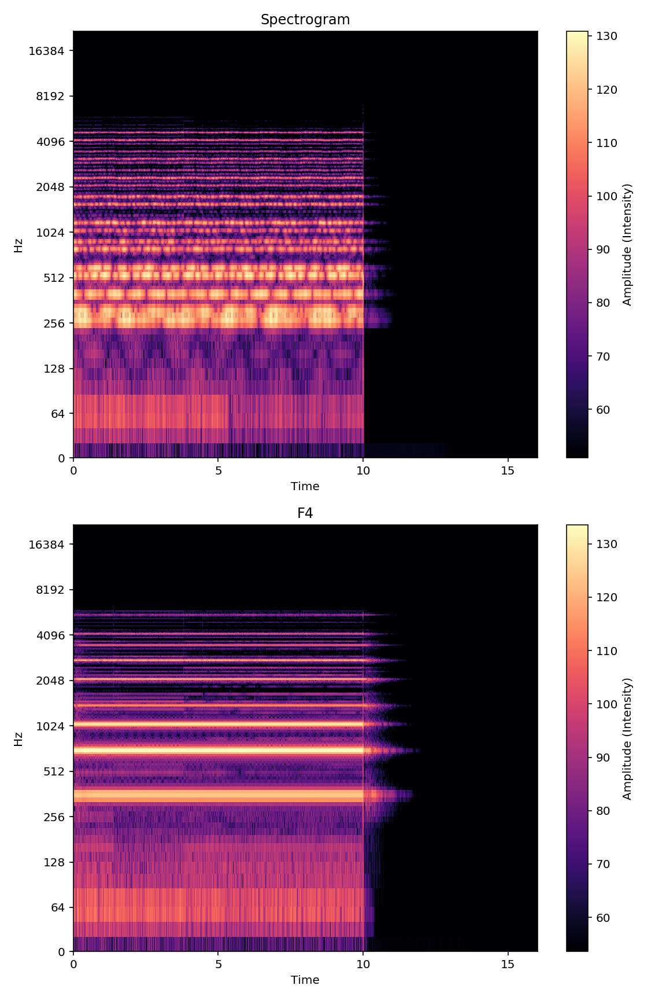

In [164]:
classifier('1.wav')

This audio file is classified as an F4 note


<IPython.core.display.Javascript object>


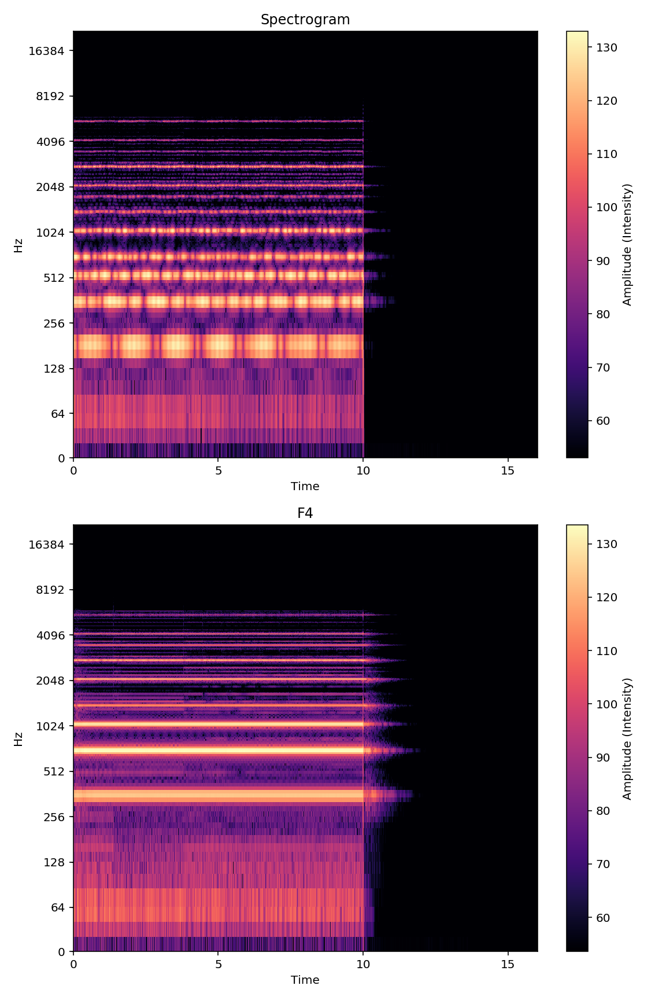

In [165]:
classifier('2.wav')

This audio file is classified as an A4 note


<IPython.core.display.Javascript object>


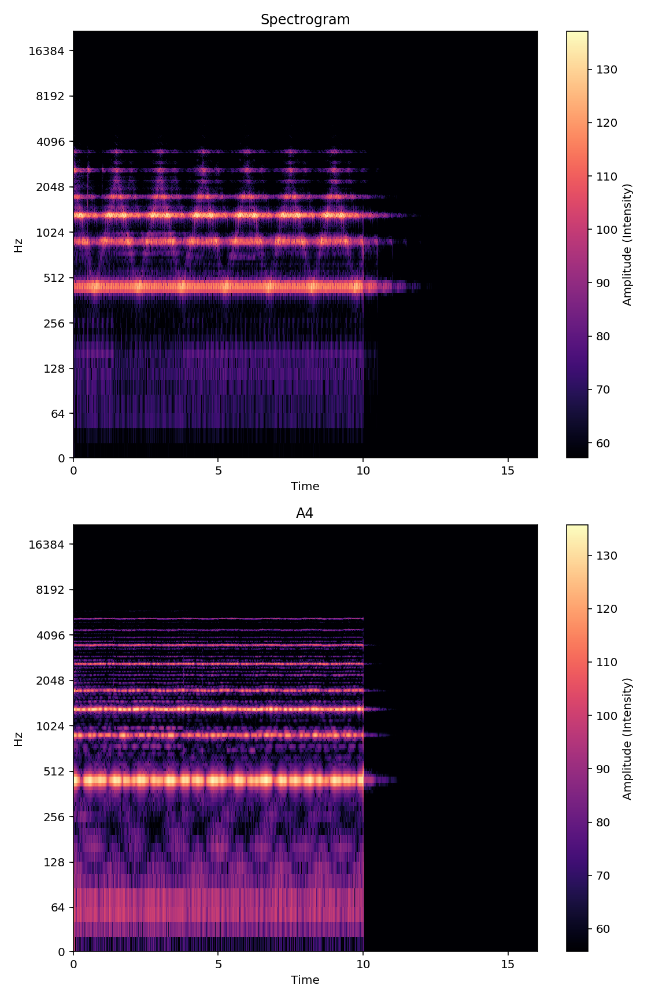

In [166]:
classifier('3.wav')

This audio file is classified as an A4 note


<IPython.core.display.Javascript object>


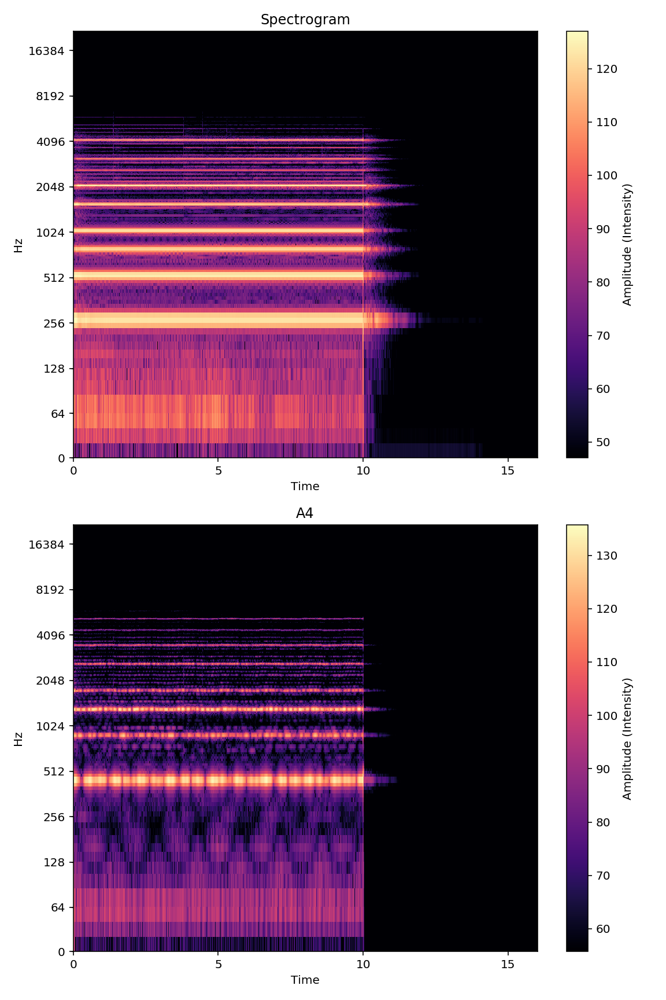

In [167]:
classifier('4.wav')

This audio file is classified as an F3 note


<IPython.core.display.Javascript object>


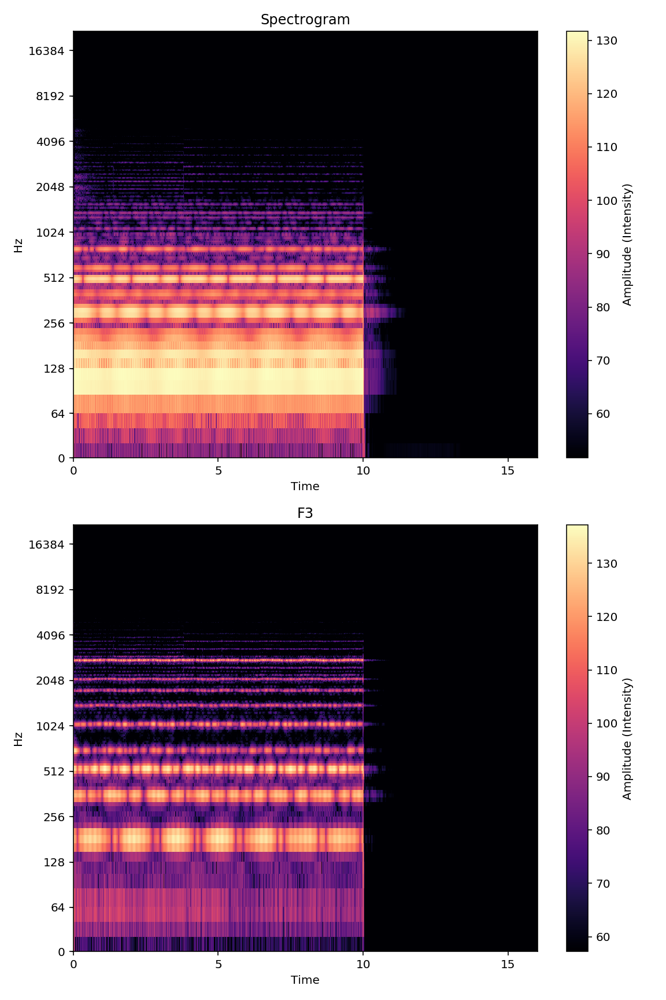

In [168]:
classifier('5.wav')

This audio file is classified as an A4 note


<IPython.core.display.Javascript object>


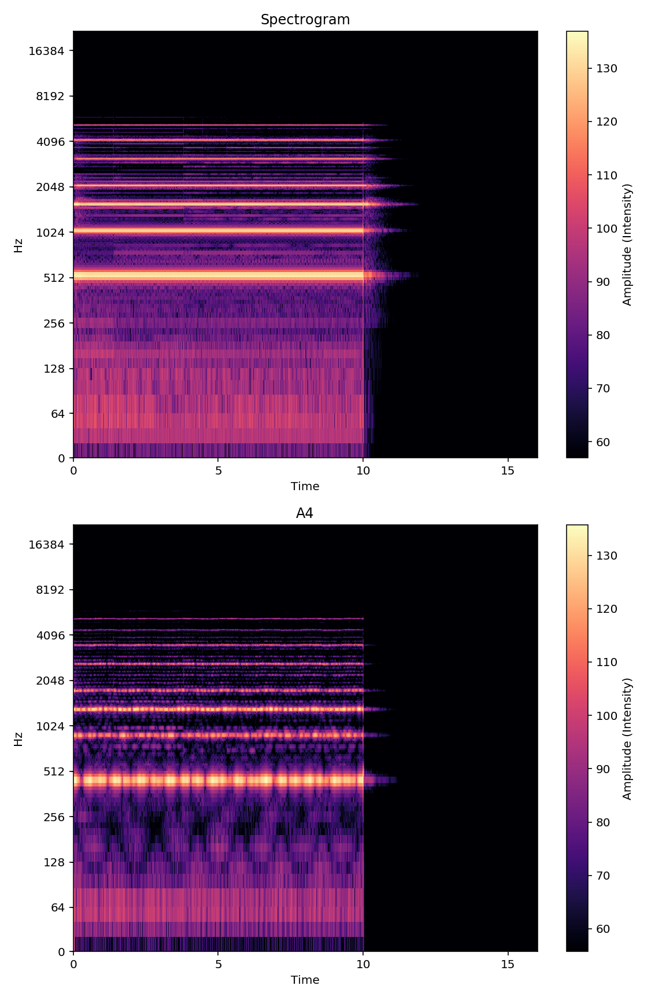

In [169]:
classifier('6.wav')

This audio file is classified as an A4 note


<IPython.core.display.Javascript object>


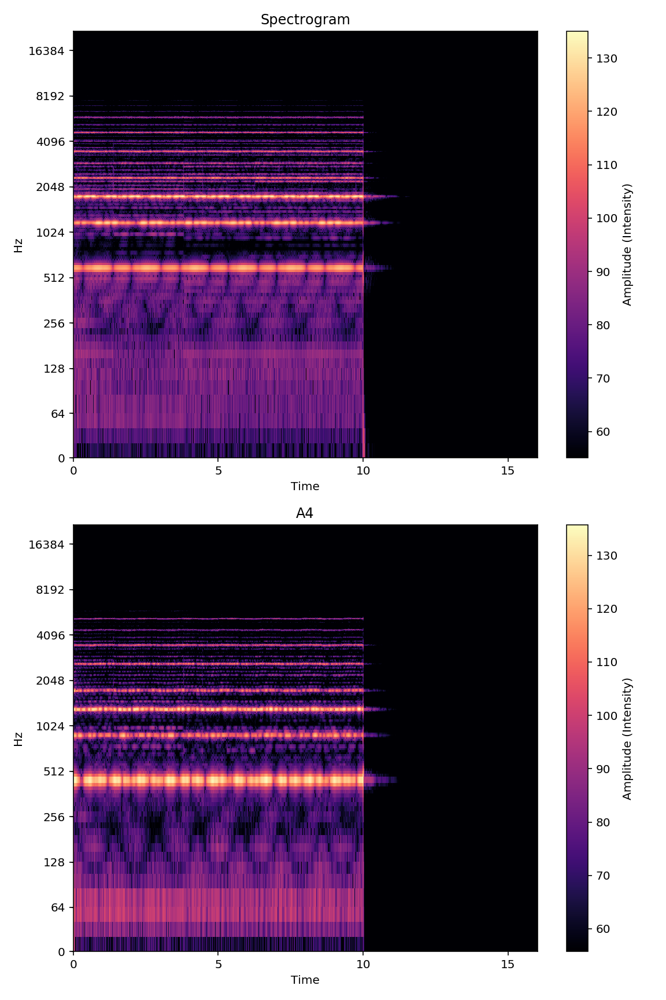

In [170]:
classifier('7.wav')

This audio file is classified as an F4 note


<IPython.core.display.Javascript object>


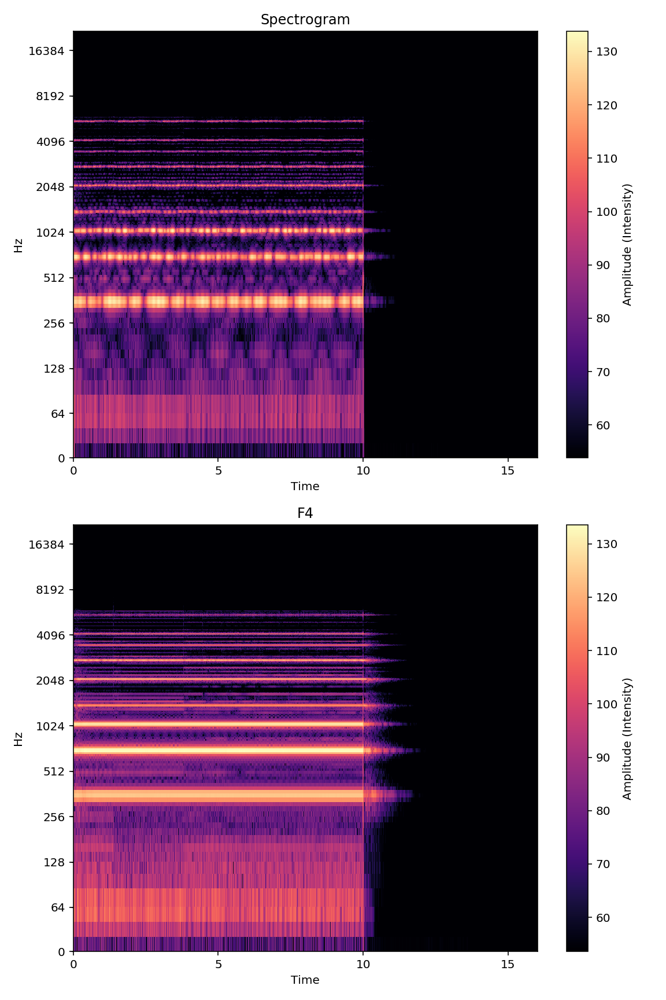

In [171]:
classifier('8.wav')

This audio file is classified as an F3 note


<IPython.core.display.Javascript object>


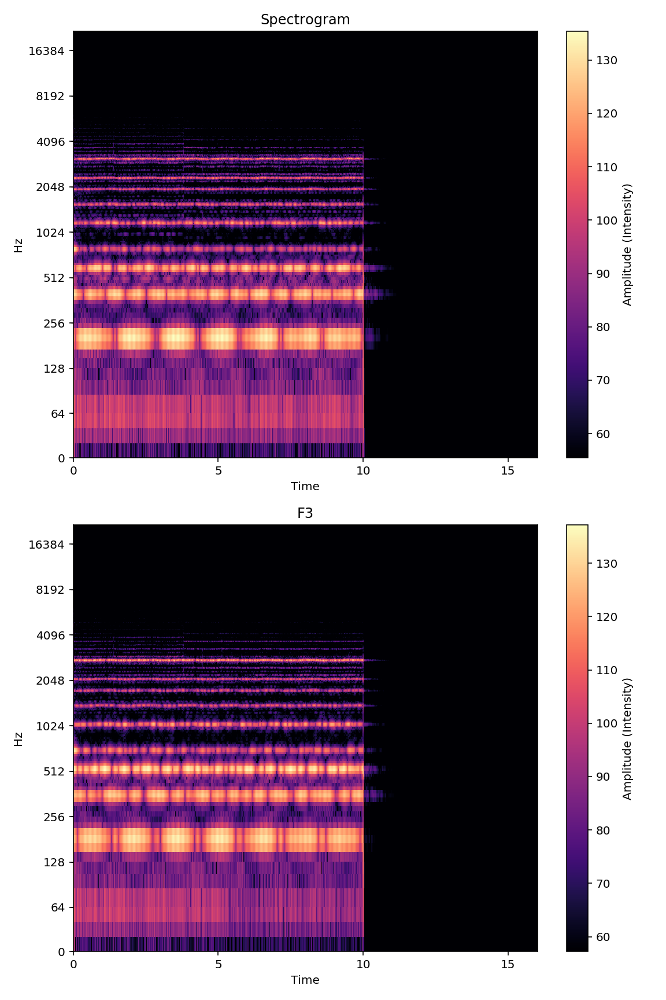

In [172]:
classifier('9.wav')

This audio file is classified as an F3 note


<IPython.core.display.Javascript object>


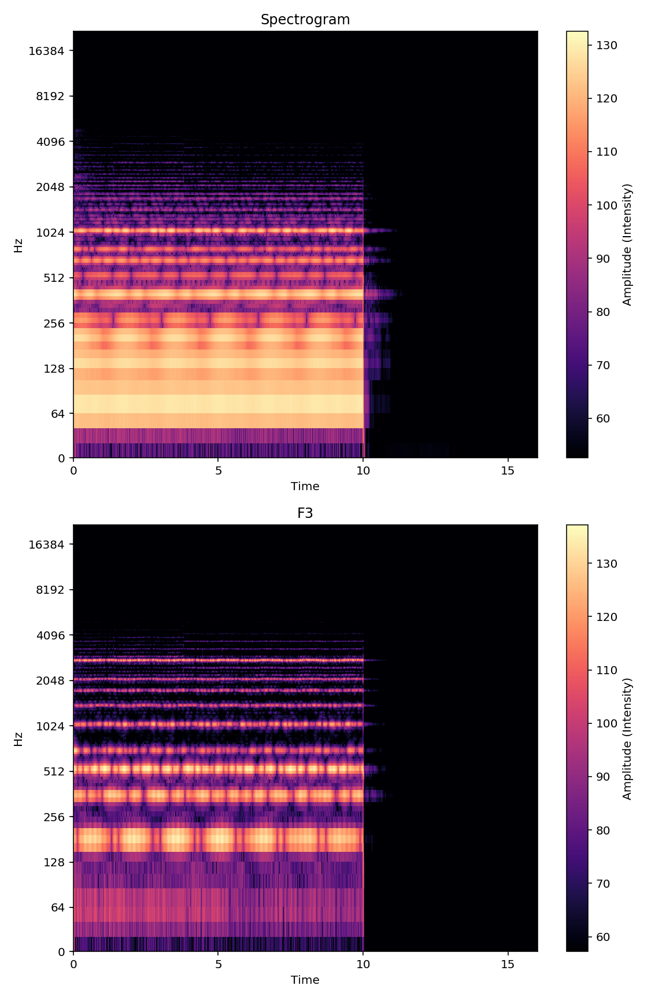

In [173]:
classifier('10.wav')

This audio file is classified as an F3 note


<IPython.core.display.Javascript object>


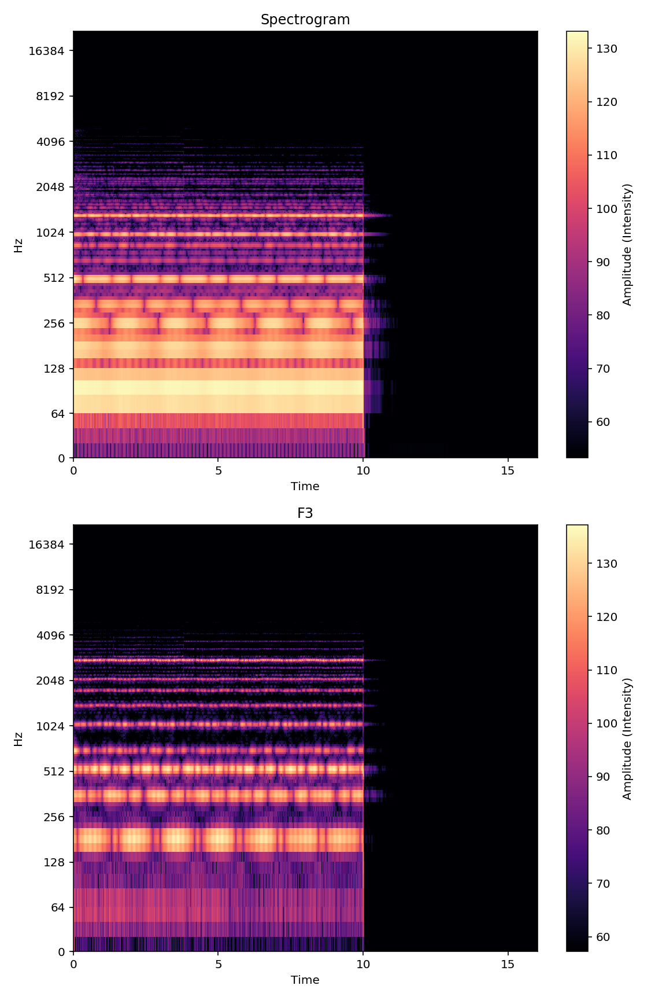

In [174]:
classifier('11.wav')

This audio file is classified as an F3 note


<IPython.core.display.Javascript object>


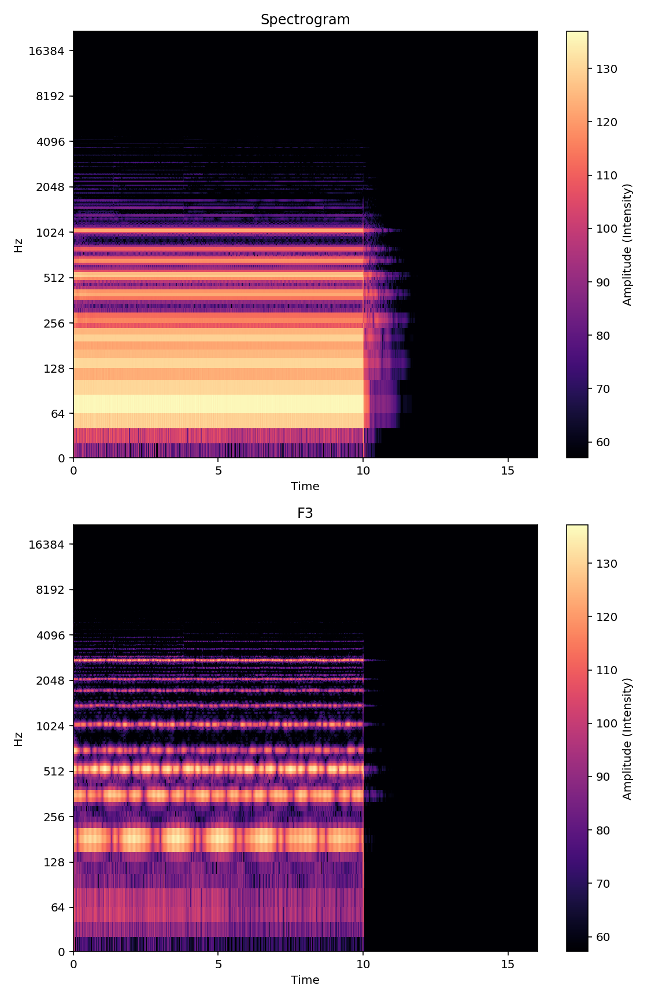

In [175]:
classifier('12.wav')

This audio file is classified as an A4 note


<IPython.core.display.Javascript object>


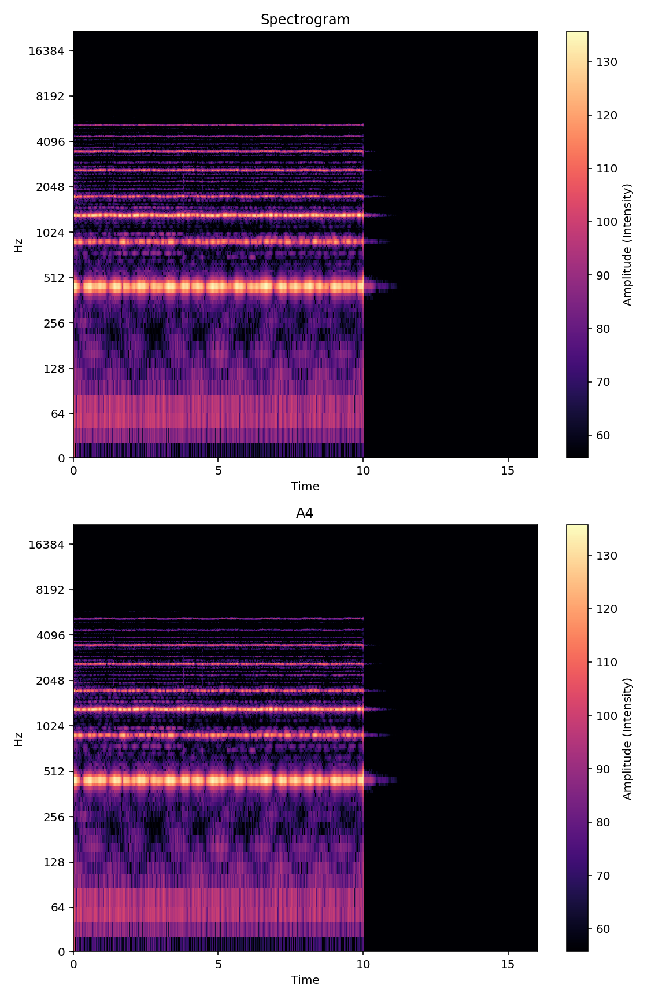

In [176]:
classifier('A4_PopOrgan.wav')

This audio file is classified as an A4 note


<IPython.core.display.Javascript object>


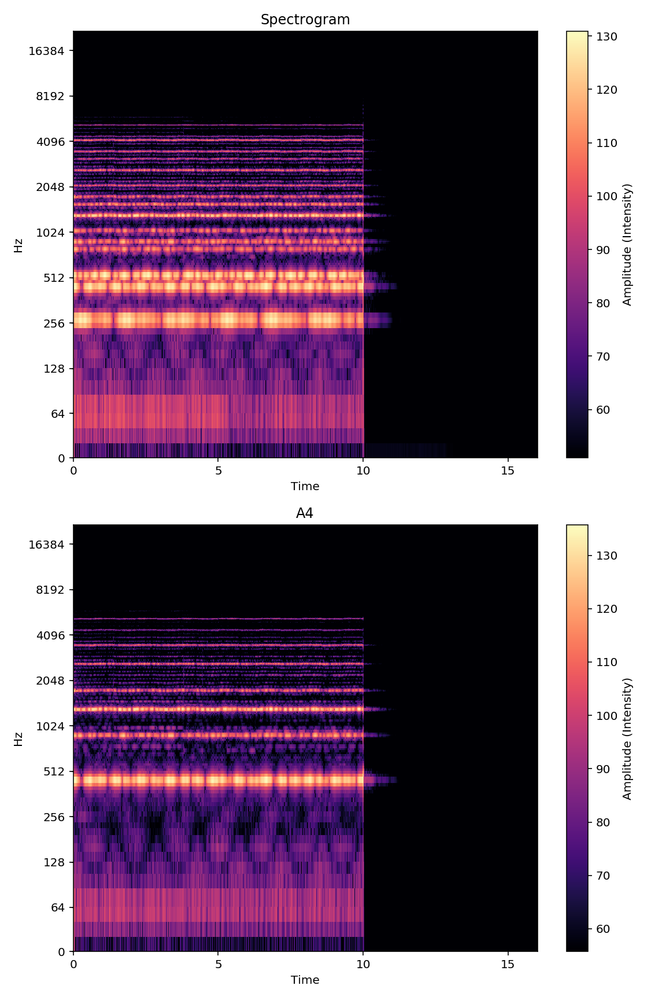

In [177]:
classifier('C4+A4_PopOrgan.wav')

This audio file is classified as an F3 note


<IPython.core.display.Javascript object>


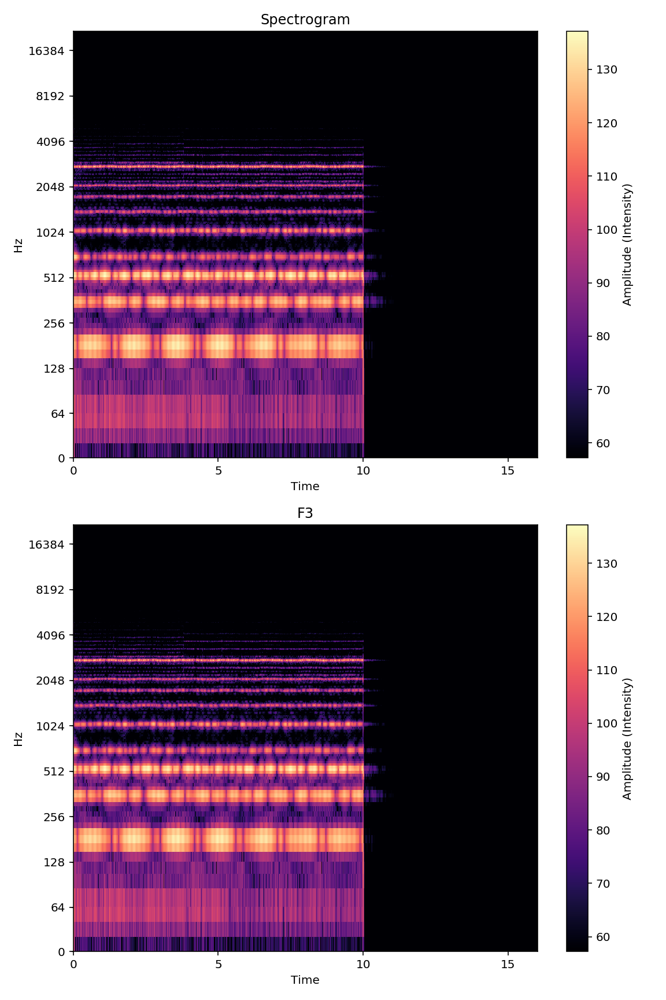

In [178]:
classifier('F3_PopOrgan.wav')

This audio file is classified as an A4 note


<IPython.core.display.Javascript object>


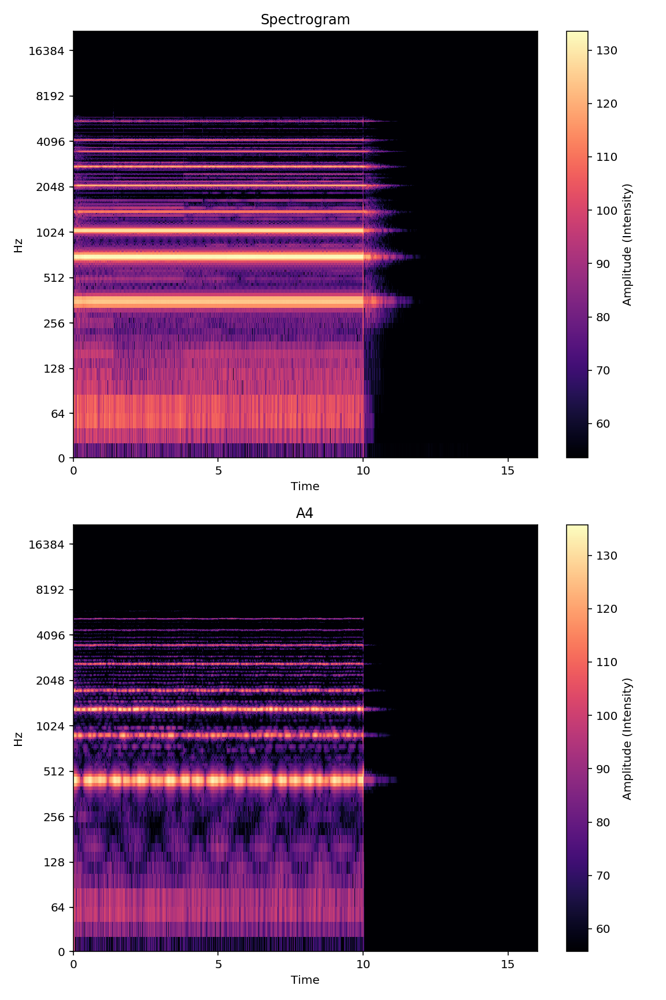

In [179]:
classifier('F4_CathedralOrgan.wav')

# Results: Part 3
Above you can see pictured several instances of the classifier being used, along with spectrograms of the input audio and the classified audio. From the spectrograms we can see that the classifier is quite accurate, but not perfect. As stated before, it gets F4 wrong because the max frequency for F4 in the frequency domain doesn't correspond with 350 Hz. Additionally, this classifier is very limited, as it can only compare audio to 3 types of frequencies. The problem with this classifier doesn't lie in the Fourier Transform -- as that is working perfectly and as it should --  but rather in the method taken in comparing the audio files to frequencies.

# Conclusion
As someone taking a signal processing course next semester and genuinely interested in the fields of signals and controls, this project allowed me to learn a lot -- about both Fourier Transforms and signals themselves. The Fourier Transform is a remarkable work of mathematics that blows my mind every time I hear about its applications.

In the first two parts of this project I merely examined some audio files and played around with employing Fourier filtering, but the entire time I was working on those parts the Fourier Transform simply didn't seem necessary. In fact, it had very little purpose, and this was for a few reasons.

First, my sample sizes for the audio were far too long and far too varied. The more and more I kept working through this project the more I kept reading online about Fourier Transforms, and learning that usually the Fourier Transform is used for small sets of data. For a large set of data, it should be used in several sequences, stepping through the data with the transform itself. In this case, I wasn't really doing that, and so the Fourier Transform wasn't showing its true potential.

Second, as I was working with the instruments' audio I really shouldn't have focused on cleaning the waveplot diagrams at all, but rather focused on comparing the frequency domain to the outputs of the spectrogram. Again, I realized this at the complete end while doing classification that using Fourier filtering effectively removes the less important frequencies from a signal.

However, the point of the Fourier Transform and filtering made clear, perfect sense once I started working on the classification. The time domain is just far too jumbled up to get any good analysis from, and for a goal such as classification you need to be able to analyze the data clearly. Hence the frequency domain.

# Future Goals
Though I'll be submitting this project now, this is likely something I'm going to keep working on. I'm particularly interested in getting a machine learning approach to work for classification. Additionally, I'd like to explore other types of filters and see which work best for what applications.